In [2]:
from model.dcgan import *
from my_utils.GAN_plot import *

Random Seed:  999


In [3]:
from __future__ import print_function
#%matplotlib inline

import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

manualSeed = 999

print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [4]:
# Root directory for dataset
dataroot = "data/afhq/train"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 256
image_size = 64
nc = 3 #channels
nz = 100 # Size of z latent vector (i.e. size of generator input)
ngf = 64 # Size of feature maps in generator
ndf = 64 # Size of feature maps in discriminator
num_epochs = 20 # Number of training epochs

lr = 0.0002
beta1 = 0.5 #for adam optim

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 2

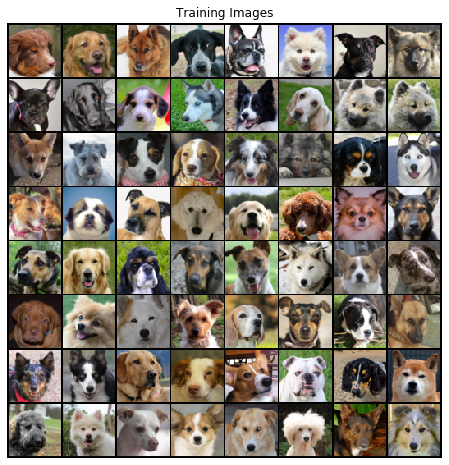

In [5]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset


mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]


dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize(mean, std)
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2

In [7]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    

In [8]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)


# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# a)

In [15]:
def callback(epoch,netG,netD,exp = "exp1"):
    if epoch % 5 == 0 and epoch != 0:
        # do checkpointing
        torch.save(netG.state_dict(), 'model_zoo/netG_epoch_%d.pth' % (epoch))
        torch.save(netD.state_dict(), 'model_zoo/netD_epoch_%d.pth' % (epoch))

In [40]:

# torch.save(netG.state_dict(), 'model_zoo/netG_101.pth' )
# torch.save(netD.state_dict(), 'model_zoo/netD_101.pth' )

In [16]:
# def train(netG, netD, dataloader, criterion, optimizerD, optimizerG, device, num_epochs=5):

# Training Loop
G_losses, D_losses, D_accuracy, img_list = train(netG, netD, dataloader, criterion, optimizerD, optimizerG, device, num_epochs= 20)


Starting Training Loop...
[0/20][0/19]	Loss_D: 1.7530	Loss_G: 5.8989	D(x): 0.5696	D(G(z)): 0.5983 / 0.0045
[1/20][0/19]	Loss_D: 3.1744	Loss_G: 16.2077	D(x): 0.9289	D(G(z)): 0.9231 / 0.0000
[2/20][0/19]	Loss_D: 0.2068	Loss_G: 9.8492	D(x): 0.8793	D(G(z)): 0.0206 / 0.0001
[3/20][0/19]	Loss_D: 0.5963	Loss_G: 11.5160	D(x): 0.8662	D(G(z)): 0.3031 / 0.0001
[4/20][0/19]	Loss_D: 0.4211	Loss_G: 4.6931	D(x): 0.7956	D(G(z)): 0.0822 / 0.0195
[5/20][0/19]	Loss_D: 0.3646	Loss_G: 5.7128	D(x): 0.9066	D(G(z)): 0.1992 / 0.0057
[6/20][0/19]	Loss_D: 0.3368	Loss_G: 3.3806	D(x): 0.9214	D(G(z)): 0.1862 / 0.0613
[7/20][0/19]	Loss_D: 0.6999	Loss_G: 5.8161	D(x): 0.8332	D(G(z)): 0.3225 / 0.0052
[8/20][0/19]	Loss_D: 0.6320	Loss_G: 5.8034	D(x): 0.8511	D(G(z)): 0.3271 / 0.0052
[9/20][0/19]	Loss_D: 0.4750	Loss_G: 3.2913	D(x): 0.8163	D(G(z)): 0.1784 / 0.0530
[10/20][0/19]	Loss_D: 0.7076	Loss_G: 2.0132	D(x): 0.6594	D(G(z)): 0.1123 / 0.2170
[11/20][0/19]	Loss_D: 0.4215	Loss_G: 5.5831	D(x): 0.7769	D(G(z)): 0.0698 / 0.005

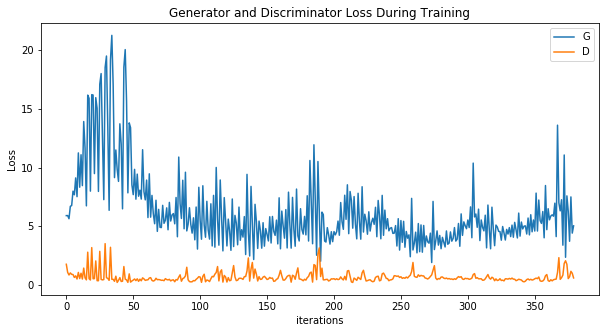

In [17]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


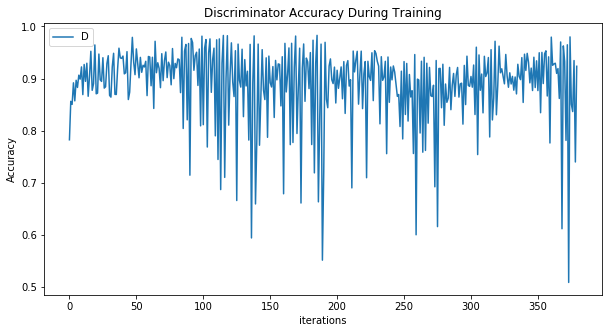

In [18]:
# discriminator accuracy
plt.figure(figsize=(10,5))
plt.title("Discriminator Accuracy During Training")
plt.plot(D_accuracy,label="D")
plt.xlabel("iterations")
plt.ylabel("Accuracy")
plt.legend()
plt.show()


In [22]:
class dummy_optimizer:
    def __init__(self):
        pass
    def step(self):
        pass
    def zero_grad(self):
        pass

dummy_optim = dummy_optimizer()

In [30]:
# load the trained model
netG.load_state_dict(torch.load('model_zoo/exp1_netG_epoch_40.pth'))
netD.load_state_dict(torch.load('model_zoo/exp1_netD_epoch_40.pth'))



<All keys matched successfully>

In [53]:
# dir(optimizerD )
# change lr of optimizerD
optimizerD = optim.Adam(netD.parameters(), lr=lr/4, betas=(beta1, 0.999))

In [54]:
# freeze the discriminator
# for param in netD.parameters():
#     param.requires_grad = False
    


# Training Loop

# G_losses, D_losses, D_accuracy, img_list = train(netG, netD, dataloader, criterion, dummy_optim, optimizerG, device, num_epochs= 2)
G_losses, D_losses, D_accuracy, img_list = train(netG, netD, dataloader, criterion, optimizerD, optimizerG, device, num_epochs= 10)

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.5935	Loss_G: 0.9866	D(x): 0.4905	D(G(z)): 0.5325 / 0.3982


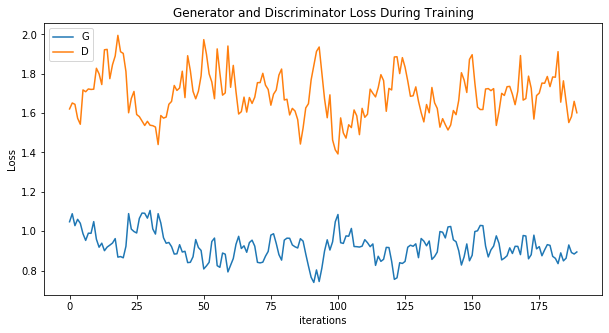

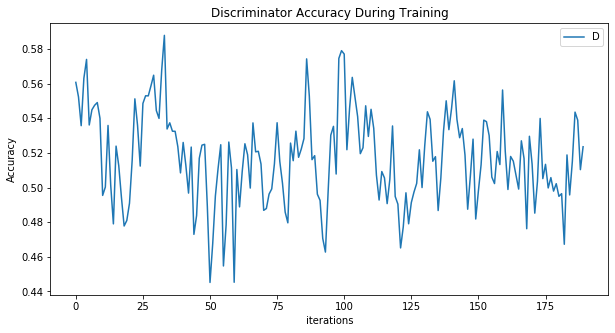

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()


# discriminator accuracy
plt.figure(figsize=(10,5))
plt.title("Discriminator Accuracy During Training")
plt.plot(D_accuracy,label="D")
plt.xlabel("iterations")
plt.ylabel("Accuracy")
plt.legend()
plt.show()



In [ ]:
# see generator output for fixed noise
fake = netG(fixed_noise).detach().cpu()
plt.figure(figsize=(16,16))
plt.axis("off")
plt.title("generated images")
plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True),(1,2,0)))


# b) Hyper params

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.4932	Loss_G: 7.8982	D(x): 0.4554	D(G(z)): 0.4625 / 0.0008
[1/10][0/38]	Loss_D: 3.9871	Loss_G: 1.9149	D(x): 0.5006	D(G(z)): 0.5541 / 0.4685
[2/10][0/38]	Loss_D: 2.3733	Loss_G: 2.7715	D(x): 0.4315	D(G(z)): 0.3913 / 0.2060
[3/10][0/38]	Loss_D: 1.8188	Loss_G: 0.8450	D(x): 0.5483	D(G(z)): 0.4480 / 0.5580
[4/10][0/38]	Loss_D: 1.6979	Loss_G: 2.4418	D(x): 0.7908	D(G(z)): 0.5651 / 0.1835
[5/10][0/38]	Loss_D: 0.6626	Loss_G: 3.4491	D(x): 0.6462	D(G(z)): 0.0928 / 0.0792
[6/10][0/38]	Loss_D: 1.7761	Loss_G: 2.3421	D(x): 0.7526	D(G(z)): 0.5742 / 0.1869
[7/10][0/38]	Loss_D: 1.1868	Loss_G: 1.8755	D(x): 0.6385	D(G(z)): 0.3878 / 0.2159
[8/10][0/38]	Loss_D: 1.7386	Loss_G: 3.8785	D(x): 0.8548	D(G(z)): 0.7055 / 0.0570
[9/10][0/38]	Loss_D: 1.4656	Loss_G: 1.6933	D(x): 0.4062	D(G(z)): 0.2006 / 0.2524


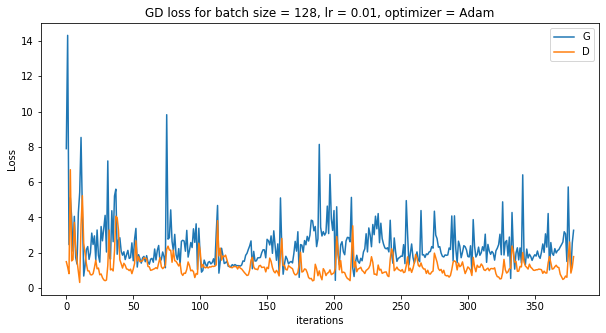

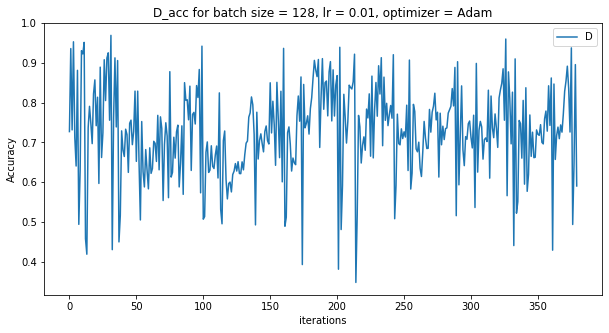

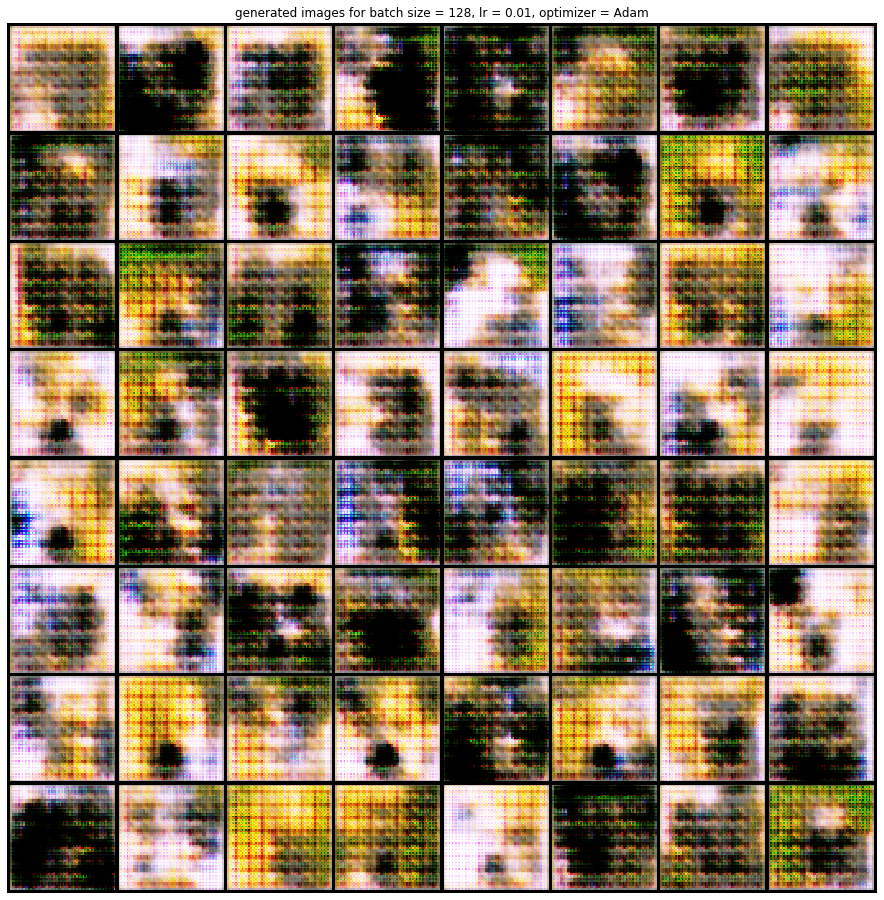

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.6642	Loss_G: 3.0029	D(x): 0.6979	D(G(z)): 0.7076 / 0.0616
[1/10][0/38]	Loss_D: 1.1088	Loss_G: 36.3703	D(x): 0.9320	D(G(z)): 0.0416 / 0.0098
[2/10][0/38]	Loss_D: 0.0000	Loss_G: 52.7618	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[3/10][0/38]	Loss_D: 2.2570	Loss_G: 26.6974	D(x): 0.7180	D(G(z)): 0.0154 / 0.0061
[4/10][0/38]	Loss_D: 4.3235	Loss_G: 14.6510	D(x): 0.4979	D(G(z)): 0.1263 / 0.0798
[5/10][0/38]	Loss_D: 0.2457	Loss_G: 4.8067	D(x): 0.9761	D(G(z)): 0.1312 / 0.0803
[6/10][0/38]	Loss_D: 0.1182	Loss_G: 5.9608	D(x): 0.9746	D(G(z)): 0.0570 / 0.0434
[7/10][0/38]	Loss_D: 0.0646	Loss_G: 5.8188	D(x): 0.9848	D(G(z)): 0.0407 / 0.0280
[8/10][0/38]	Loss_D: 0.0683	Loss_G: 4.7923	D(x): 0.9890	D(G(z)): 0.0480 / 0.0400
[9/10][0/38]	Loss_D: 0.0162	Loss_G: 8.9532	D(x): 0.9924	D(G(z)): 0.0075 / 0.0047


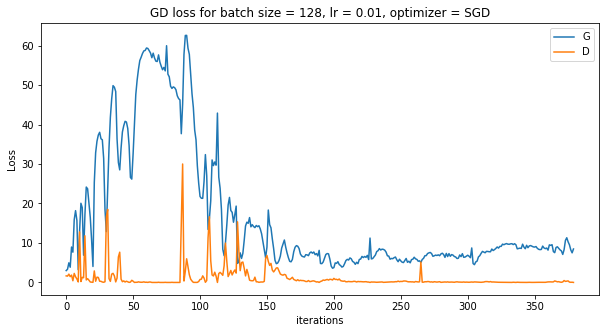

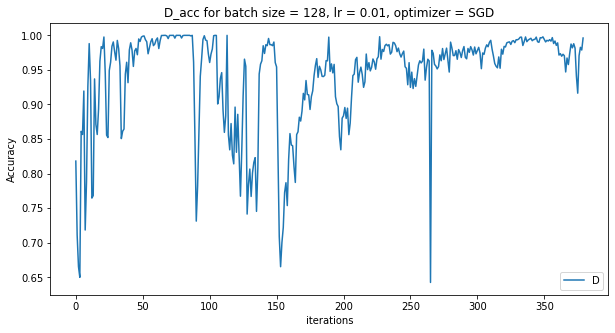

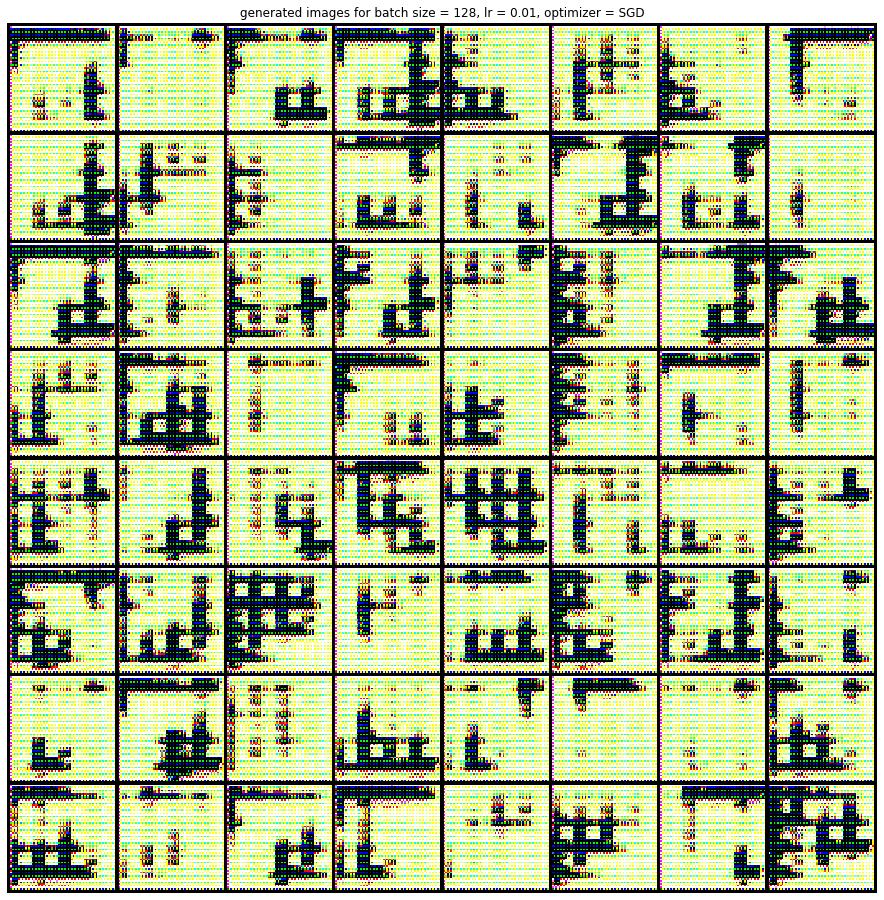

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.3009	Loss_G: 0.0129	D(x): 0.5161	D(G(z)): 0.4382 / 0.9880
[1/10][0/38]	Loss_D: 4.4173	Loss_G: 5.7673	D(x): 0.4347	D(G(z)): 0.2213 / 0.1938
[2/10][0/38]	Loss_D: 2.1791	Loss_G: 1.7483	D(x): 0.3652	D(G(z)): 0.3721 / 0.2929
[3/10][0/38]	Loss_D: 2.9001	Loss_G: 1.4833	D(x): 0.2045	D(G(z)): 0.2207 / 0.3011
[4/10][0/38]	Loss_D: 2.4282	Loss_G: 1.1566	D(x): 0.2480	D(G(z)): 0.3304 / 0.4012
[5/10][0/38]	Loss_D: 2.7506	Loss_G: 1.7796	D(x): 0.6717	D(G(z)): 0.7347 / 0.2215
[6/10][0/38]	Loss_D: 1.5771	Loss_G: 1.5544	D(x): 0.4618	D(G(z)): 0.3634 / 0.2528
[7/10][0/38]	Loss_D: 2.1835	Loss_G: 1.2444	D(x): 0.3429	D(G(z)): 0.3236 / 0.3642
[8/10][0/38]	Loss_D: 2.0080	Loss_G: 1.5686	D(x): 0.4504	D(G(z)): 0.5423 / 0.2408
[9/10][0/38]	Loss_D: 2.5617	Loss_G: 2.2614	D(x): 0.4478	D(G(z)): 0.6223 / 0.1250


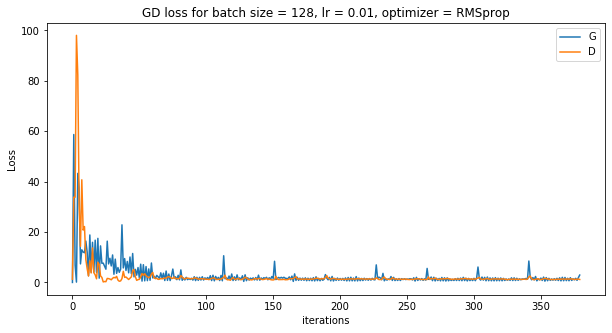

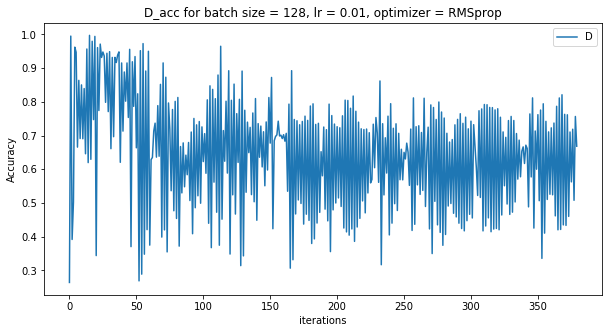

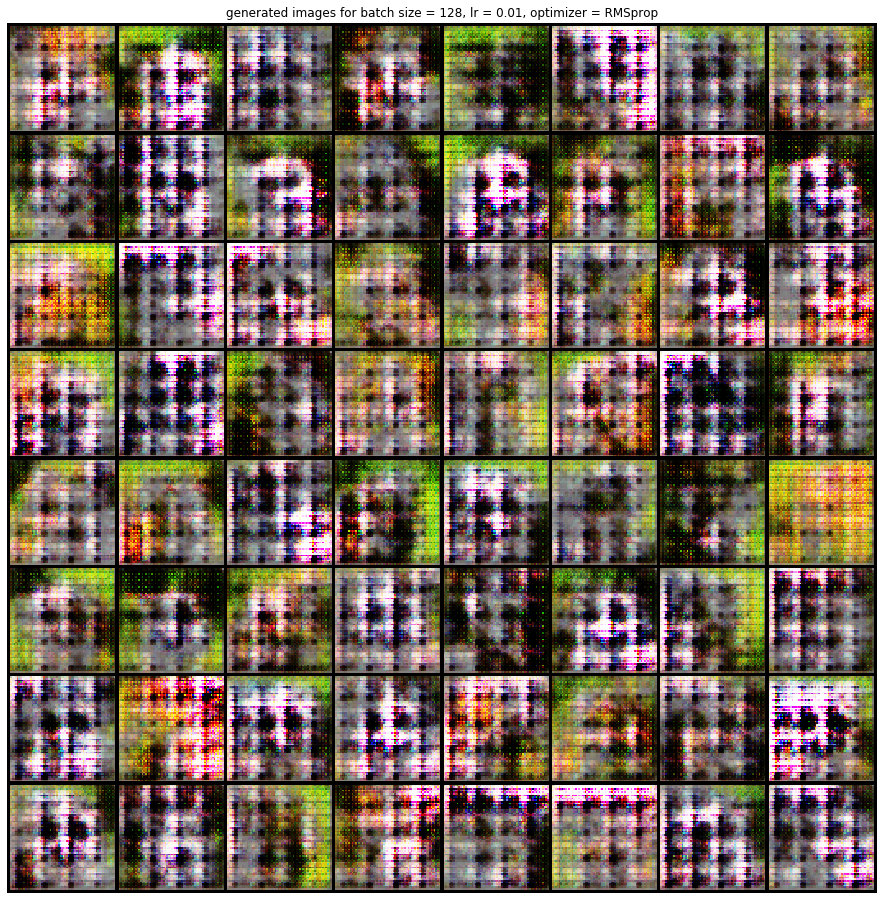

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.7524	Loss_G: 3.4002	D(x): 0.5324	D(G(z)): 0.6383 / 0.0403
[1/10][0/38]	Loss_D: 1.5044	Loss_G: 5.7928	D(x): 0.9236	D(G(z)): 0.7042 / 0.0075
[2/10][0/38]	Loss_D: 1.1390	Loss_G: 2.0044	D(x): 0.7559	D(G(z)): 0.5067 / 0.1827
[3/10][0/38]	Loss_D: 2.0407	Loss_G: 2.4270	D(x): 0.5615	D(G(z)): 0.6651 / 0.1180
[4/10][0/38]	Loss_D: 1.8231	Loss_G: 2.0920	D(x): 0.7965	D(G(z)): 0.7420 / 0.1573
[5/10][0/38]	Loss_D: 1.0393	Loss_G: 2.7573	D(x): 0.7083	D(G(z)): 0.4298 / 0.0812
[6/10][0/38]	Loss_D: 1.9308	Loss_G: 1.0830	D(x): 0.2400	D(G(z)): 0.0683 / 0.4298
[7/10][0/38]	Loss_D: 0.9920	Loss_G: 3.3638	D(x): 0.7522	D(G(z)): 0.4356 / 0.0514
[8/10][0/38]	Loss_D: 1.1857	Loss_G: 1.3806	D(x): 0.4858	D(G(z)): 0.1042 / 0.4274
[9/10][0/38]	Loss_D: 1.5869	Loss_G: 3.6332	D(x): 0.8952	D(G(z)): 0.7005 / 0.0502


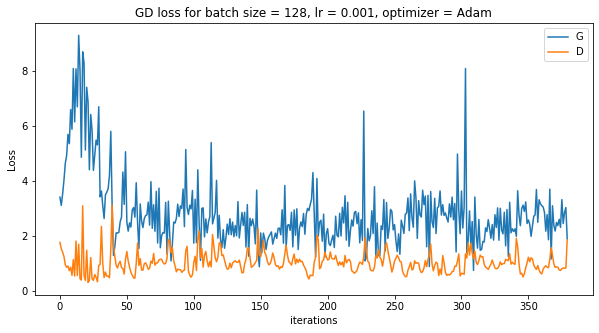

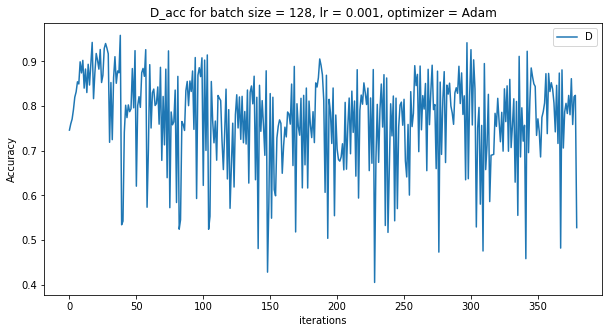

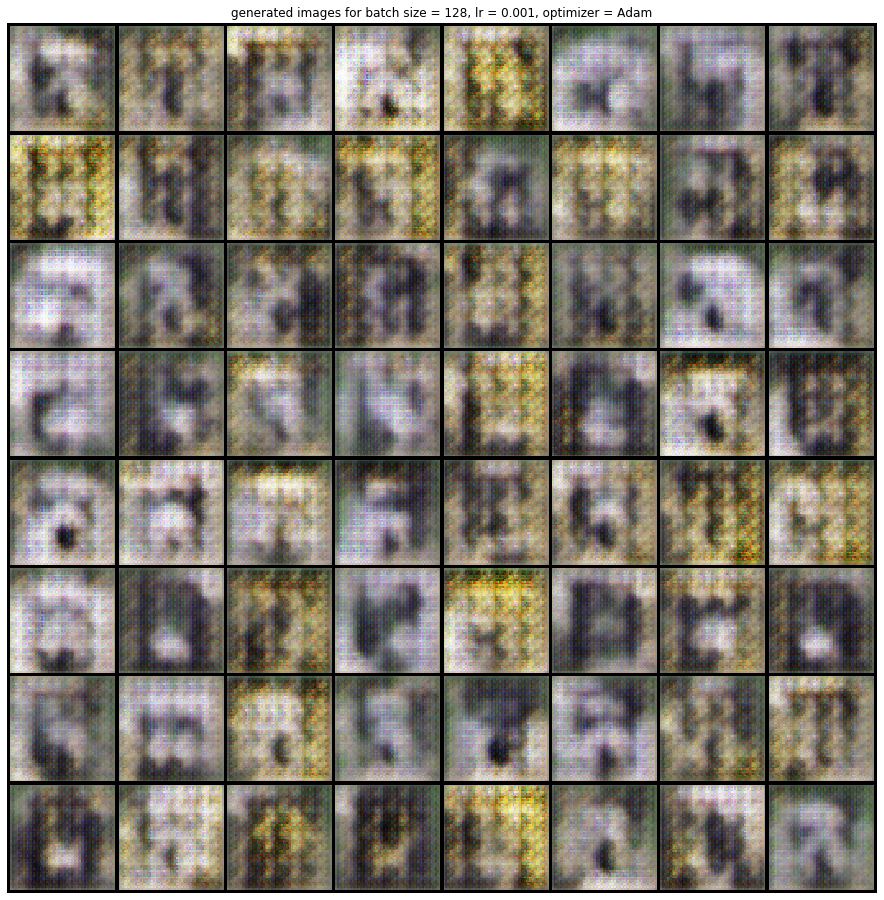

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.4879	Loss_G: 0.8967	D(x): 0.4582	D(G(z)): 0.4697 / 0.4297
[1/10][0/38]	Loss_D: 0.3270	Loss_G: 6.3624	D(x): 0.9916	D(G(z)): 0.2560 / 0.0023
[2/10][0/38]	Loss_D: 0.0570	Loss_G: 8.5824	D(x): 0.9653	D(G(z)): 0.0055 / 0.0003
[3/10][0/38]	Loss_D: 0.0160	Loss_G: 6.0349	D(x): 0.9911	D(G(z)): 0.0069 / 0.0025
[4/10][0/38]	Loss_D: 0.1683	Loss_G: 10.2491	D(x): 0.9388	D(G(z)): 0.0844 / 0.0000
[5/10][0/38]	Loss_D: 0.0066	Loss_G: 6.6385	D(x): 0.9965	D(G(z)): 0.0030 / 0.0014
[6/10][0/38]	Loss_D: 0.0076	Loss_G: 6.2629	D(x): 0.9970	D(G(z)): 0.0046 / 0.0022
[7/10][0/38]	Loss_D: 0.0402	Loss_G: 3.6987	D(x): 0.9973	D(G(z)): 0.0366 / 0.0265
[8/10][0/38]	Loss_D: 0.0280	Loss_G: 7.9970	D(x): 0.9793	D(G(z)): 0.0015 / 0.0005
[9/10][0/38]	Loss_D: 0.0351	Loss_G: 7.3419	D(x): 0.9795	D(G(z)): 0.0039 / 0.0010


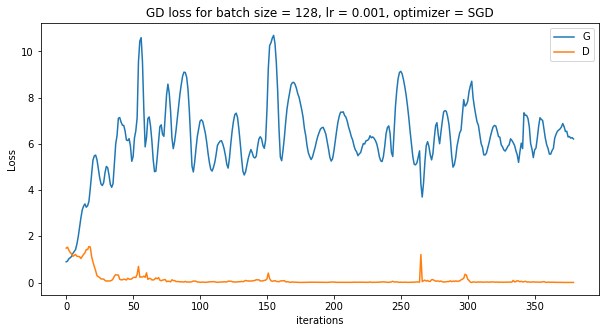

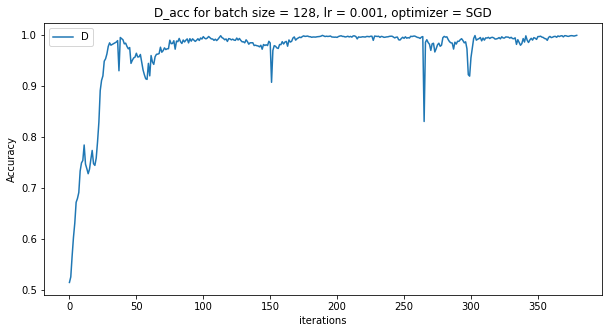

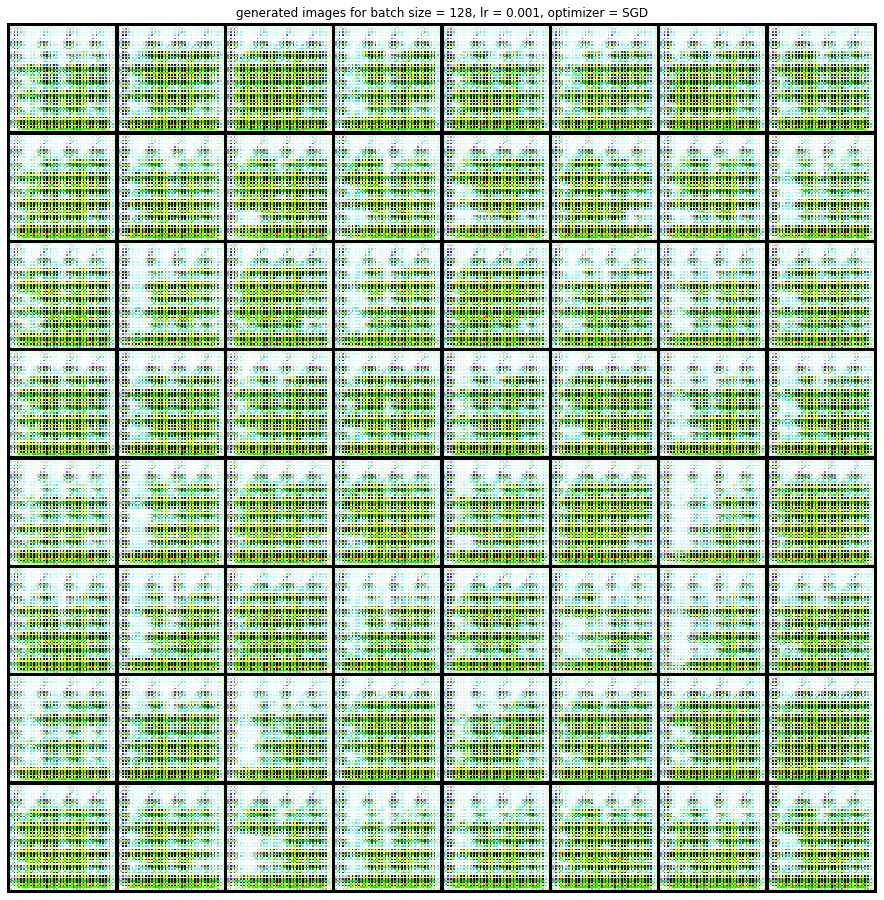

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.6686	Loss_G: 2.0620	D(x): 0.3737	D(G(z)): 0.4376 / 0.1913
[1/10][0/38]	Loss_D: 0.9191	Loss_G: 1.0370	D(x): 0.5720	D(G(z)): 0.2118 / 0.4082
[2/10][0/38]	Loss_D: 1.9526	Loss_G: 0.8166	D(x): 0.2490	D(G(z)): 0.2687 / 0.4743
[3/10][0/38]	Loss_D: 1.5088	Loss_G: 1.1434	D(x): 0.6489	D(G(z)): 0.5775 / 0.3457
[4/10][0/38]	Loss_D: 2.0332	Loss_G: 0.9831	D(x): 0.3260	D(G(z)): 0.4827 / 0.3956
[5/10][0/38]	Loss_D: 2.3824	Loss_G: 1.9631	D(x): 0.5781	D(G(z)): 0.7631 / 0.1757
[6/10][0/38]	Loss_D: 1.6596	Loss_G: 1.8856	D(x): 0.5952	D(G(z)): 0.6236 / 0.1744
[7/10][0/38]	Loss_D: 1.2322	Loss_G: 1.6716	D(x): 0.6293	D(G(z)): 0.4836 / 0.2053
[8/10][0/38]	Loss_D: 1.5227	Loss_G: 0.9571	D(x): 0.3742	D(G(z)): 0.3440 / 0.4021
[9/10][0/38]	Loss_D: 2.1671	Loss_G: 1.5159	D(x): 0.4137	D(G(z)): 0.5999 / 0.2501


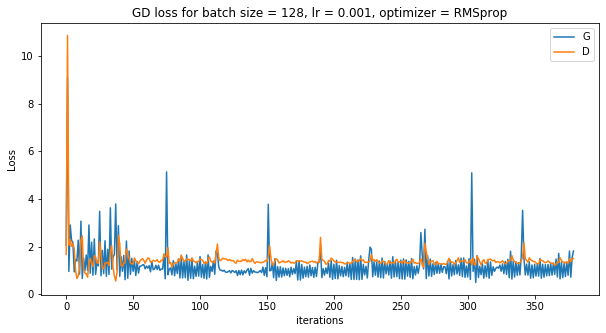

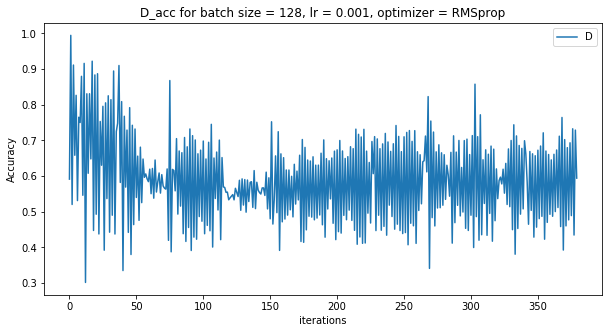

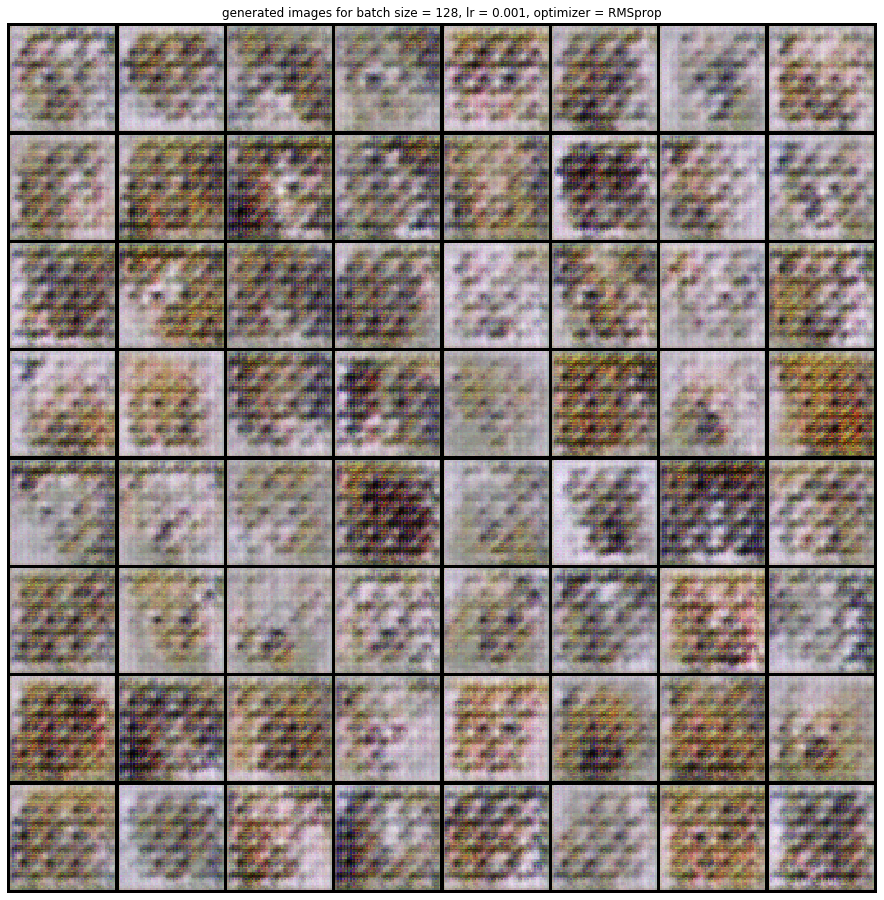

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.4295	Loss_G: 2.0118	D(x): 0.5736	D(G(z)): 0.5550 / 0.1467
[1/10][0/38]	Loss_D: 1.1466	Loss_G: 2.4376	D(x): 0.4793	D(G(z)): 0.0582 / 0.1633
[2/10][0/38]	Loss_D: 1.5655	Loss_G: 3.5557	D(x): 0.9228	D(G(z)): 0.6556 / 0.0334
[3/10][0/38]	Loss_D: 0.9303	Loss_G: 3.5044	D(x): 0.8401	D(G(z)): 0.4700 / 0.0402
[4/10][0/38]	Loss_D: 0.9338	Loss_G: 5.1899	D(x): 0.9144	D(G(z)): 0.5060 / 0.0079
[5/10][0/38]	Loss_D: 1.5368	Loss_G: 2.3518	D(x): 0.6597	D(G(z)): 0.5421 / 0.1354
[6/10][0/38]	Loss_D: 0.9901	Loss_G: 2.3903	D(x): 0.5098	D(G(z)): 0.0625 / 0.1660
[7/10][0/38]	Loss_D: 0.7135	Loss_G: 3.7433	D(x): 0.7125	D(G(z)): 0.2269 / 0.0446
[8/10][0/38]	Loss_D: 1.0006	Loss_G: 3.4129	D(x): 0.7441	D(G(z)): 0.4106 / 0.0627
[9/10][0/38]	Loss_D: 3.0617	Loss_G: 2.7769	D(x): 0.9322	D(G(z)): 0.9100 / 0.1483


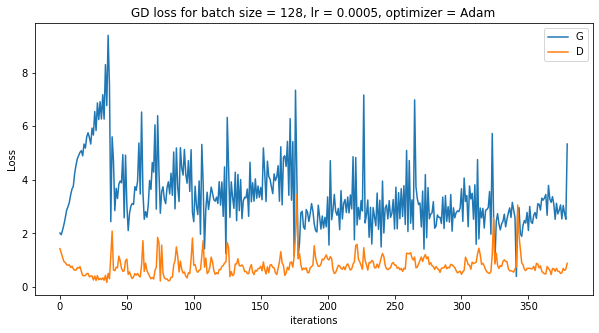

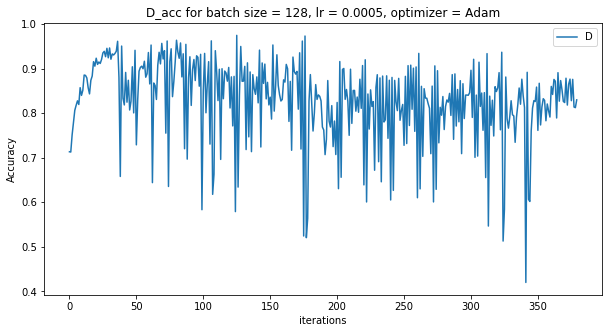

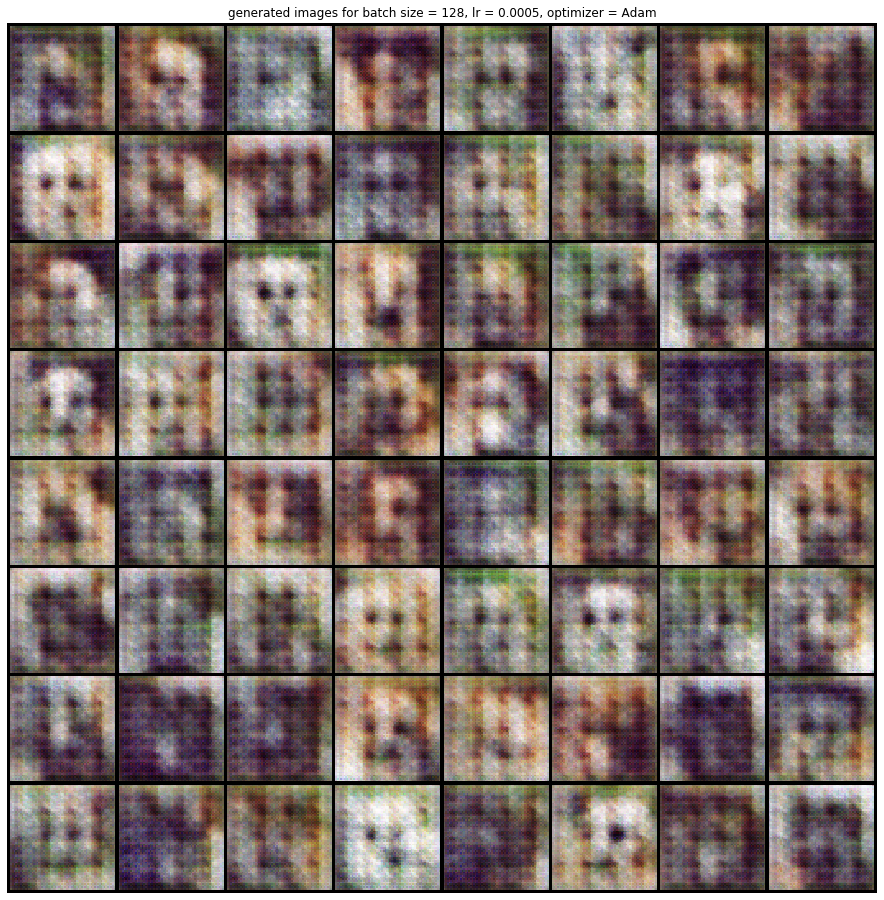

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.5492	Loss_G: 0.6517	D(x): 0.5659	D(G(z)): 0.5921 / 0.5414
[1/10][0/38]	Loss_D: 0.6562	Loss_G: 2.8126	D(x): 0.9272	D(G(z)): 0.4308 / 0.0667
[2/10][0/38]	Loss_D: 0.0524	Loss_G: 4.2759	D(x): 0.9717	D(G(z)): 0.0218 / 0.0158
[3/10][0/38]	Loss_D: 0.2292	Loss_G: 4.8764	D(x): 0.8830	D(G(z)): 0.0597 / 0.0099
[4/10][0/38]	Loss_D: 0.0239	Loss_G: 5.9342	D(x): 0.9840	D(G(z)): 0.0058 / 0.0028
[5/10][0/38]	Loss_D: 0.2121	Loss_G: 7.8370	D(x): 0.8598	D(G(z)): 0.0044 / 0.0006
[6/10][0/38]	Loss_D: 0.0311	Loss_G: 4.8456	D(x): 0.9891	D(G(z)): 0.0196 / 0.0088
[7/10][0/38]	Loss_D: 0.0117	Loss_G: 6.0140	D(x): 0.9920	D(G(z)): 0.0035 / 0.0027
[8/10][0/38]	Loss_D: 0.0171	Loss_G: 6.2251	D(x): 0.9881	D(G(z)): 0.0034 / 0.0022
[9/10][0/38]	Loss_D: 0.0529	Loss_G: 4.8480	D(x): 0.9875	D(G(z)): 0.0295 / 0.0090


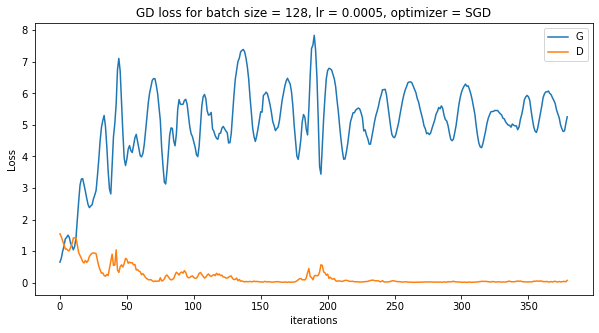

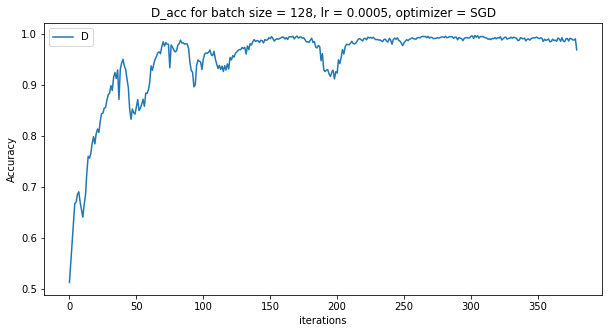

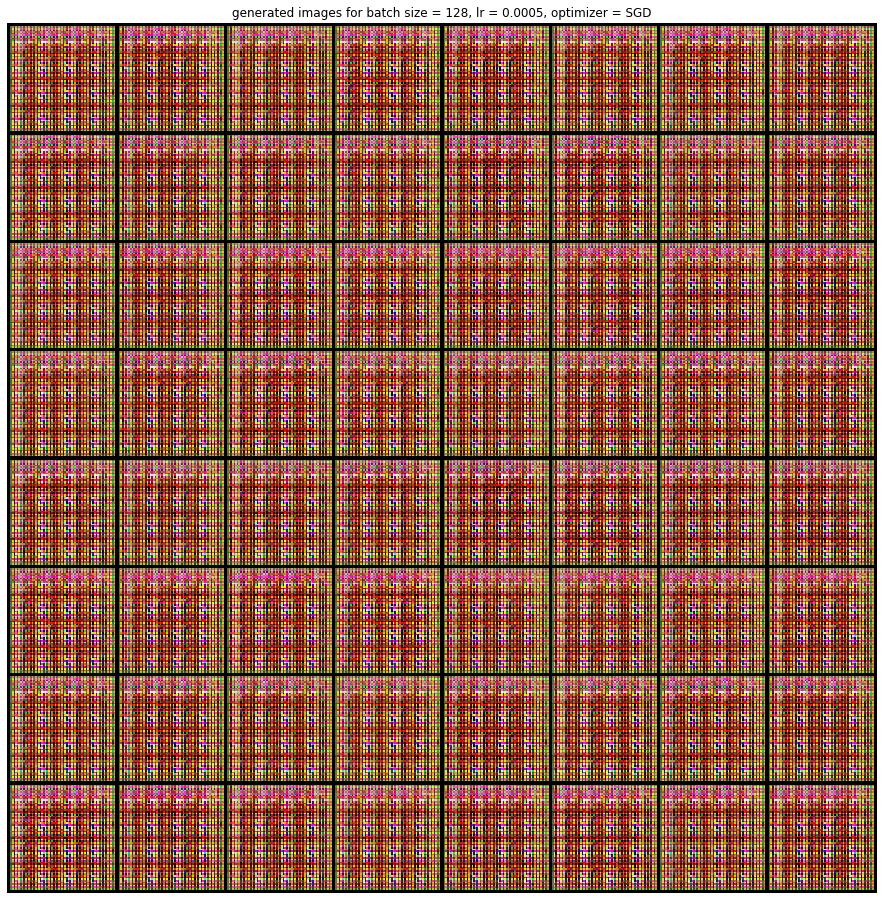

Starting Training Loop...
[0/10][0/38]	Loss_D: 1.4195	Loss_G: 9.2338	D(x): 0.5607	D(G(z)): 0.5364 / 0.0002
[1/10][0/38]	Loss_D: 0.8802	Loss_G: 2.5575	D(x): 0.8233	D(G(z)): 0.4203 / 0.0949
[2/10][0/38]	Loss_D: 1.6280	Loss_G: 0.8776	D(x): 0.3641	D(G(z)): 0.3774 / 0.4337
[3/10][0/38]	Loss_D: 1.8851	Loss_G: 0.8682	D(x): 0.3509	D(G(z)): 0.4363 / 0.4464
[4/10][0/38]	Loss_D: 1.6238	Loss_G: 1.2384	D(x): 0.6266	D(G(z)): 0.6468 / 0.3071
[5/10][0/38]	Loss_D: 1.5080	Loss_G: 1.2382	D(x): 0.5266	D(G(z)): 0.5337 / 0.3076
[6/10][0/38]	Loss_D: 1.8906	Loss_G: 1.7931	D(x): 0.5804	D(G(z)): 0.6710 / 0.1843
[7/10][0/38]	Loss_D: 1.2107	Loss_G: 0.5647	D(x): 0.4604	D(G(z)): 0.3053 / 0.5817
[8/10][0/38]	Loss_D: 1.7958	Loss_G: 1.5884	D(x): 0.4515	D(G(z)): 0.5470 / 0.2230
[9/10][0/38]	Loss_D: 1.5027	Loss_G: 0.7450	D(x): 0.4174	D(G(z)): 0.4038 / 0.4882


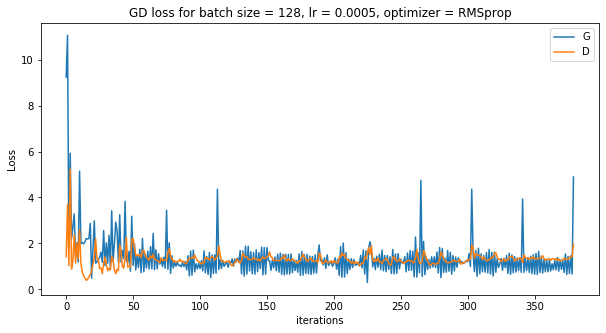

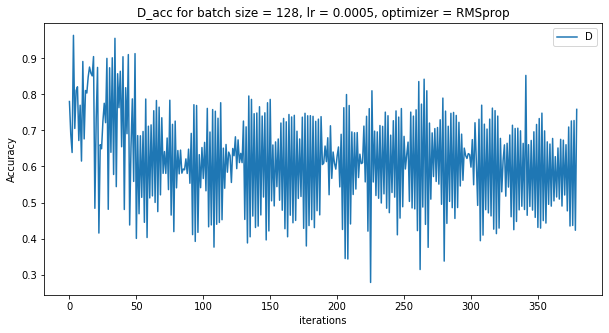

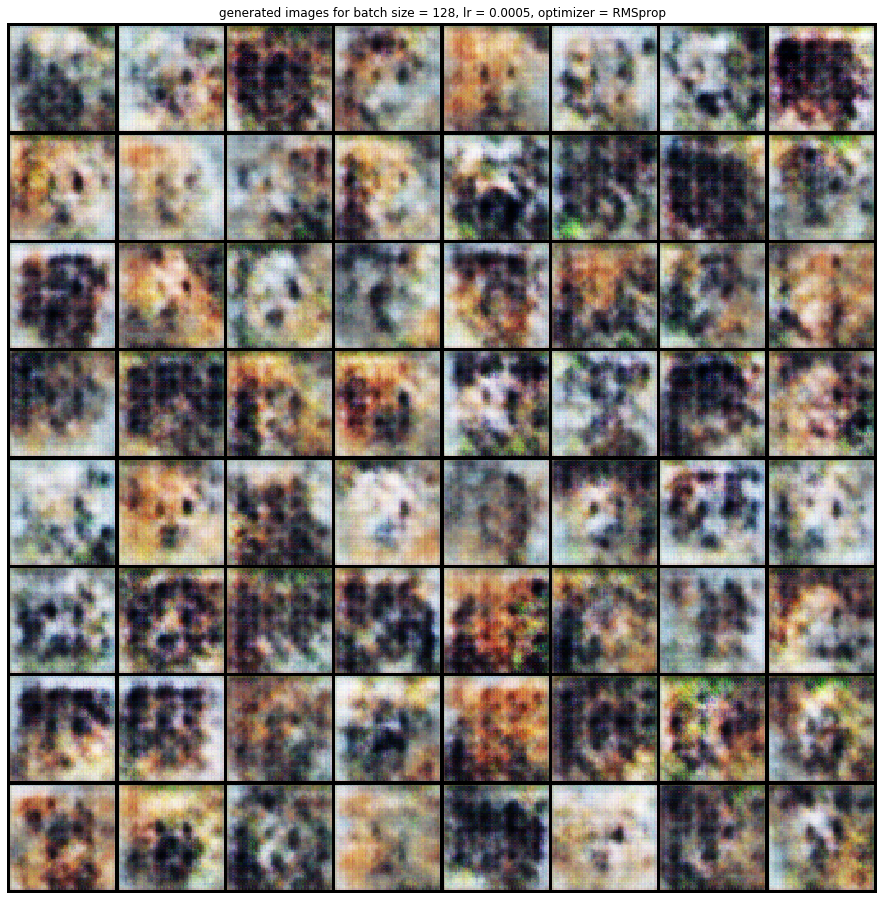

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.4434	Loss_G: 8.6151	D(x): 0.4911	D(G(z)): 0.4840 / 0.0008
[1/10][0/19]	Loss_D: 1.0999	Loss_G: 2.2960	D(x): 0.7827	D(G(z)): 0.4026 / 0.3148
[2/10][0/19]	Loss_D: 0.4267	Loss_G: 4.2990	D(x): 0.9021	D(G(z)): 0.2543 / 0.0257
[3/10][0/19]	Loss_D: 1.6499	Loss_G: 1.5683	D(x): 0.6506	D(G(z)): 0.5925 / 0.2792
[4/10][0/19]	Loss_D: 1.2834	Loss_G: 1.4091	D(x): 0.5612	D(G(z)): 0.3811 / 0.2911
[5/10][0/19]	Loss_D: 1.2181	Loss_G: 1.4373	D(x): 0.5084	D(G(z)): 0.3355 / 0.2830
[6/10][0/19]	Loss_D: 1.4397	Loss_G: 1.5116	D(x): 0.5438	D(G(z)): 0.4487 / 0.2752
[7/10][0/19]	Loss_D: 1.2168	Loss_G: 1.1353	D(x): 0.5427	D(G(z)): 0.3813 / 0.3457
[8/10][0/19]	Loss_D: 0.9992	Loss_G: 1.5287	D(x): 0.5515	D(G(z)): 0.2420 / 0.2612
[9/10][0/19]	Loss_D: 1.2699	Loss_G: 1.1899	D(x): 0.5190	D(G(z)): 0.3831 / 0.3495


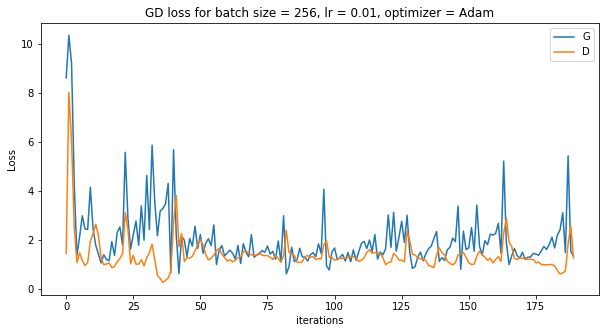

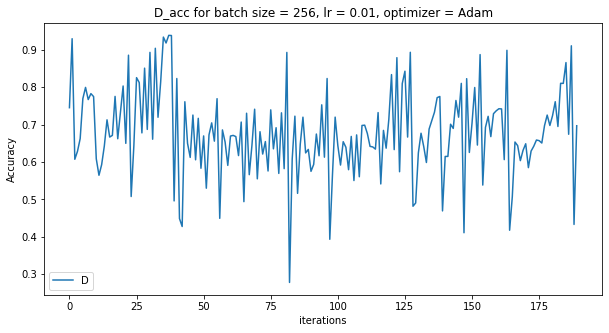

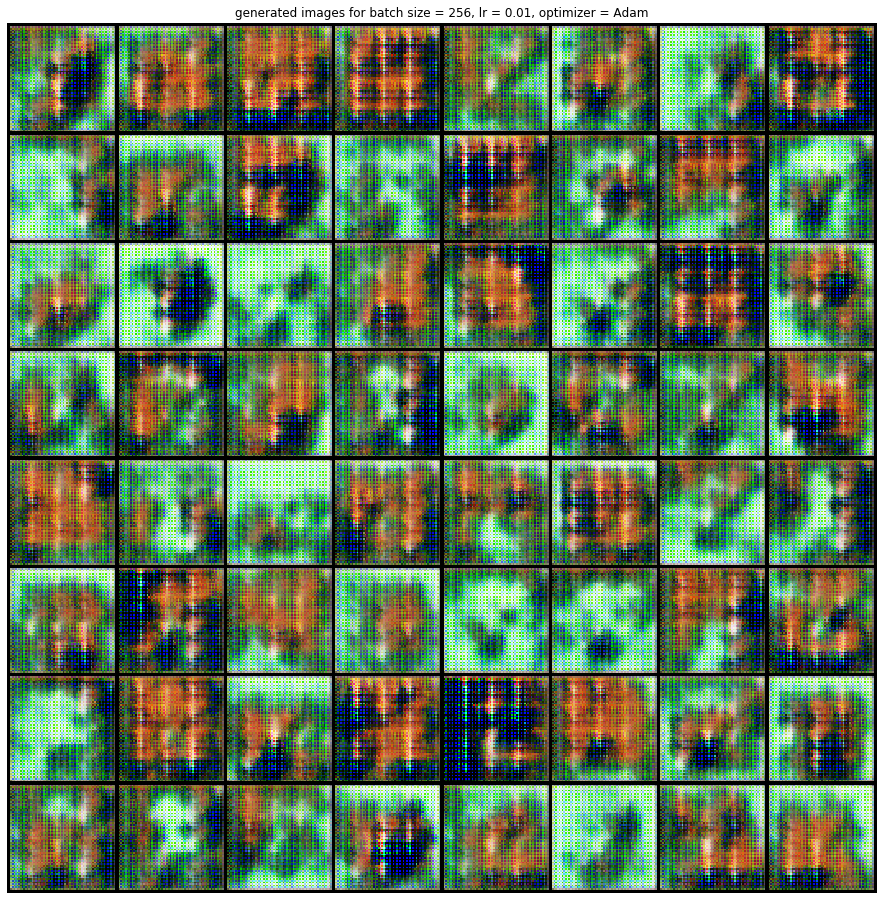

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.2646	Loss_G: 2.6070	D(x): 0.5512	D(G(z)): 0.4545 / 0.0845
[1/10][0/19]	Loss_D: 0.7075	Loss_G: 15.3778	D(x): 0.7789	D(G(z)): 0.0006 / 0.0000
[2/10][0/19]	Loss_D: 0.1276	Loss_G: 11.9787	D(x): 0.9695	D(G(z)): 0.0373 / 0.0058
[3/10][0/19]	Loss_D: 0.0756	Loss_G: 17.0885	D(x): 0.9656	D(G(z)): 0.0004 / 0.0000
[4/10][0/19]	Loss_D: 0.0039	Loss_G: 22.8695	D(x): 0.9966	D(G(z)): 0.0000 / 0.0000
[5/10][0/19]	Loss_D: 0.0275	Loss_G: 10.7233	D(x): 0.9946	D(G(z)): 0.0093 / 0.0002
[6/10][0/19]	Loss_D: 0.0007	Loss_G: 17.4334	D(x): 0.9994	D(G(z)): 0.0000 / 0.0000
[7/10][0/19]	Loss_D: 0.0000	Loss_G: 16.2495	D(x): 1.0000	D(G(z)): 0.0000 / 0.0000
[8/10][0/19]	Loss_D: 0.0010	Loss_G: 13.7203	D(x): 1.0000	D(G(z)): 0.0010 / 0.0006
[9/10][0/19]	Loss_D: 0.0002	Loss_G: 13.0265	D(x): 0.9999	D(G(z)): 0.0002 / 0.0001


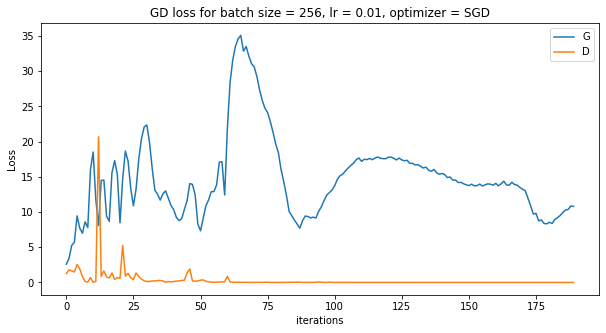

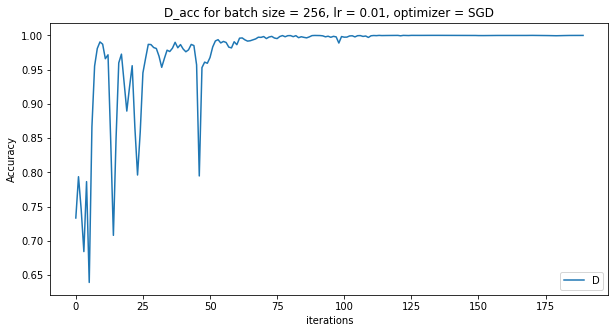

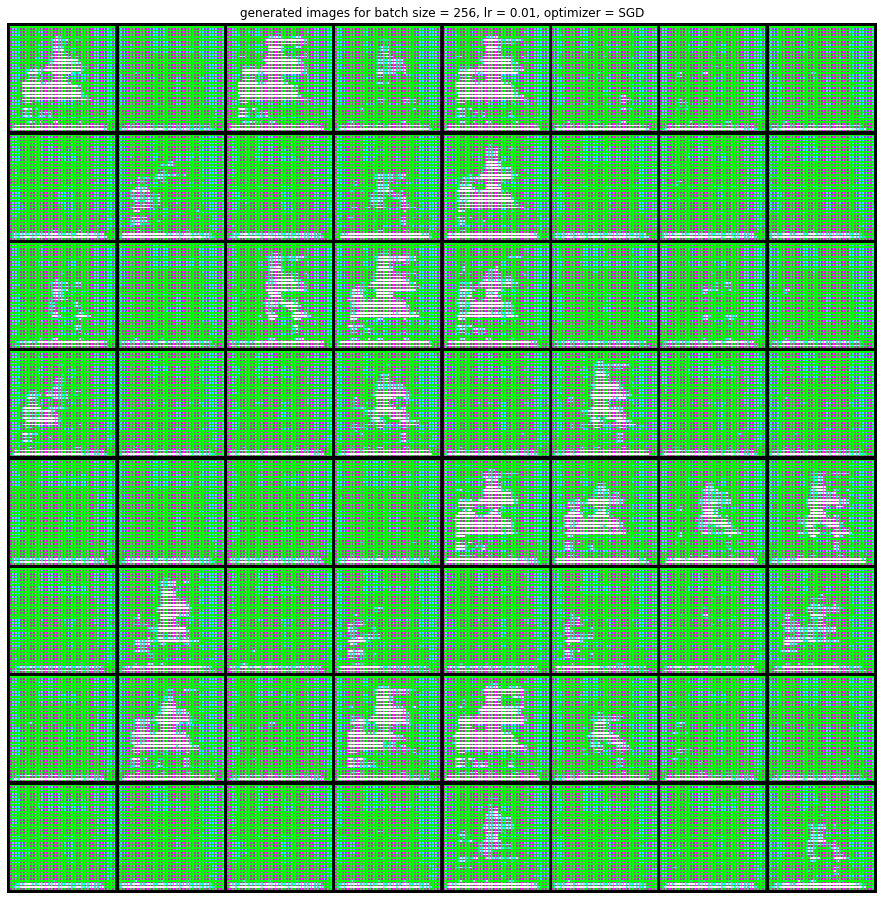

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.5222	Loss_G: 46.8111	D(x): 0.6154	D(G(z)): 0.6131 / 0.0000
[1/10][0/19]	Loss_D: 7.7763	Loss_G: 7.3094	D(x): 0.7641	D(G(z)): 0.3786 / 0.4646
[2/10][0/19]	Loss_D: 4.5643	Loss_G: 5.3658	D(x): 0.8770	D(G(z)): 0.8009 / 0.0591
[3/10][0/19]	Loss_D: 1.8711	Loss_G: 1.2883	D(x): 0.6024	D(G(z)): 0.3129 / 0.3586
[4/10][0/19]	Loss_D: 1.7465	Loss_G: 0.8119	D(x): 0.4775	D(G(z)): 0.3877 / 0.4816
[5/10][0/19]	Loss_D: 1.5689	Loss_G: 1.1638	D(x): 0.5866	D(G(z)): 0.5433 / 0.4212
[6/10][0/19]	Loss_D: 1.5968	Loss_G: 0.7545	D(x): 0.4384	D(G(z)): 0.4226 / 0.4860
[7/10][0/19]	Loss_D: 1.4029	Loss_G: 1.3177	D(x): 0.5928	D(G(z)): 0.5493 / 0.3394
[8/10][0/19]	Loss_D: 1.3532	Loss_G: 0.8964	D(x): 0.4948	D(G(z)): 0.4545 / 0.4229
[9/10][0/19]	Loss_D: 1.4814	Loss_G: 1.0068	D(x): 0.4843	D(G(z)): 0.4867 / 0.3982


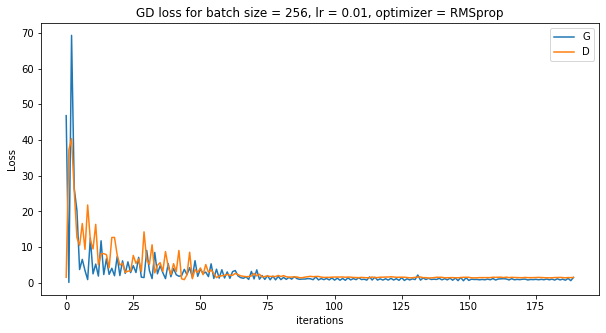

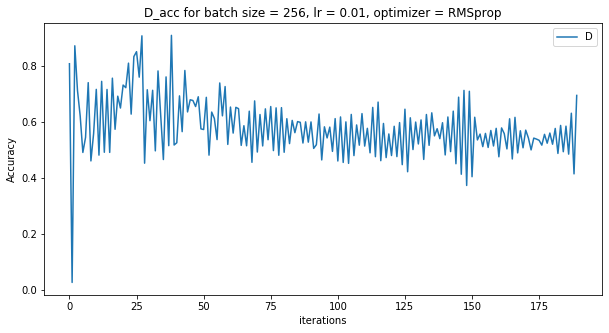

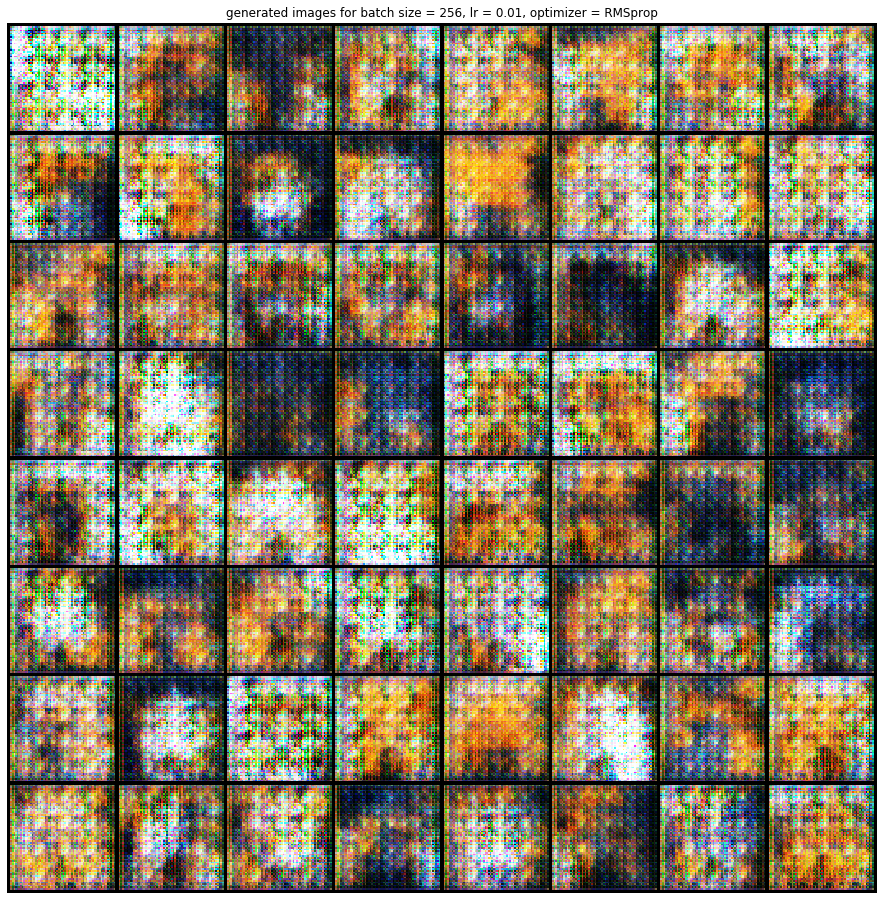

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.6132	Loss_G: 3.8680	D(x): 0.5179	D(G(z)): 0.5806 / 0.0259
[1/10][0/19]	Loss_D: 0.3671	Loss_G: 5.5873	D(x): 0.8311	D(G(z)): 0.1333 / 0.0056
[2/10][0/19]	Loss_D: 0.1717	Loss_G: 5.5944	D(x): 0.9442	D(G(z)): 0.1004 / 0.0047
[3/10][0/19]	Loss_D: 0.7898	Loss_G: 1.4680	D(x): 0.6692	D(G(z)): 0.2657 / 0.2596
[4/10][0/19]	Loss_D: 2.2245	Loss_G: 1.2467	D(x): 0.1673	D(G(z)): 0.1270 / 0.3344
[5/10][0/19]	Loss_D: 1.6112	Loss_G: 1.3264	D(x): 0.3056	D(G(z)): 0.1333 / 0.3359
[6/10][0/19]	Loss_D: 0.7614	Loss_G: 2.5707	D(x): 0.6295	D(G(z)): 0.2137 / 0.0914
[7/10][0/19]	Loss_D: 0.9571	Loss_G: 2.1279	D(x): 0.5100	D(G(z)): 0.1473 / 0.1429
[8/10][0/19]	Loss_D: 0.9796	Loss_G: 2.4802	D(x): 0.6897	D(G(z)): 0.4067 / 0.1066
[9/10][0/19]	Loss_D: 1.1106	Loss_G: 1.3603	D(x): 0.4689	D(G(z)): 0.1723 / 0.2863


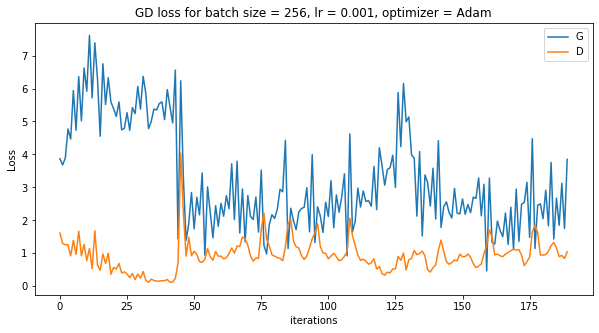

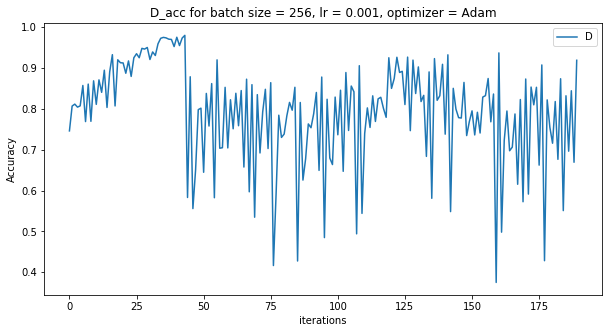

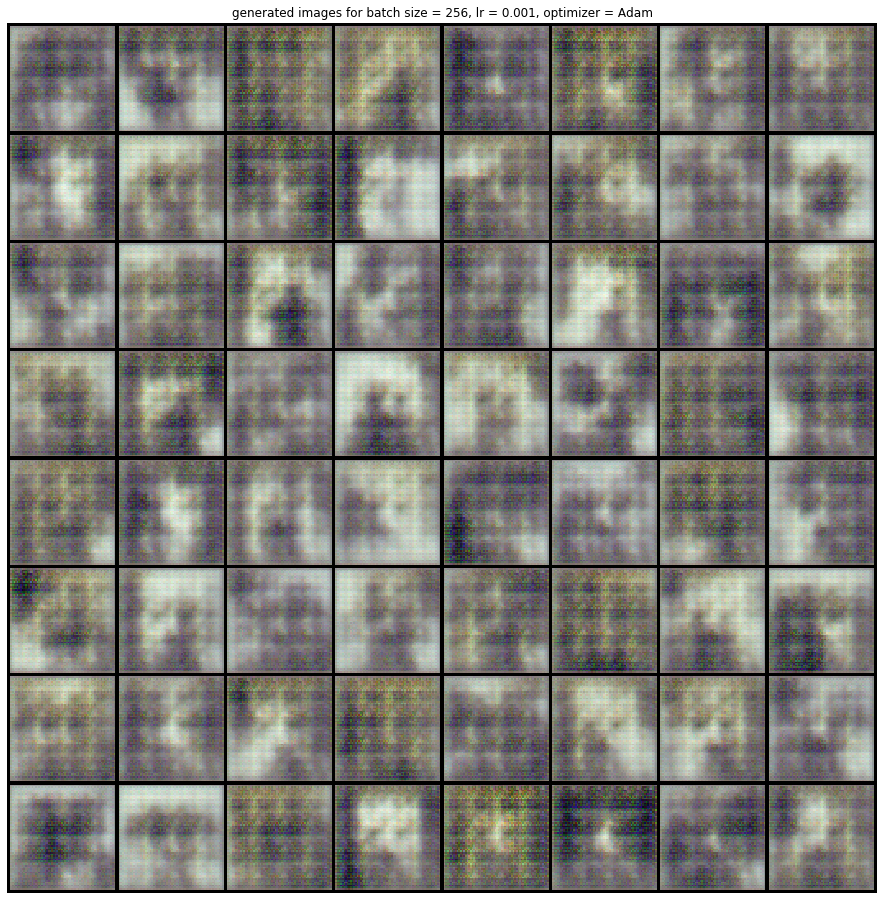

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.5885	Loss_G: 0.5816	D(x): 0.6090	D(G(z)): 0.6344 / 0.5738
[1/10][0/19]	Loss_D: 0.8540	Loss_G: 3.9352	D(x): 0.8074	D(G(z)): 0.4372 / 0.0229
[2/10][0/19]	Loss_D: 0.2456	Loss_G: 4.9442	D(x): 0.8864	D(G(z)): 0.0658 / 0.0095
[3/10][0/19]	Loss_D: 0.0299	Loss_G: 8.0230	D(x): 0.9790	D(G(z)): 0.0013 / 0.0003
[4/10][0/19]	Loss_D: 0.0381	Loss_G: 6.3242	D(x): 0.9775	D(G(z)): 0.0128 / 0.0020
[5/10][0/19]	Loss_D: 0.0455	Loss_G: 4.9656	D(x): 0.9844	D(G(z)): 0.0207 / 0.0076
[6/10][0/19]	Loss_D: 0.0522	Loss_G: 4.3852	D(x): 0.9851	D(G(z)): 0.0347 / 0.0149
[7/10][0/19]	Loss_D: 0.0975	Loss_G: 7.5876	D(x): 0.9303	D(G(z)): 0.0008 / 0.0006
[8/10][0/19]	Loss_D: 0.0064	Loss_G: 6.6012	D(x): 0.9961	D(G(z)): 0.0024 / 0.0015
[9/10][0/19]	Loss_D: 0.0143	Loss_G: 5.2633	D(x): 0.9980	D(G(z)): 0.0122 / 0.0059


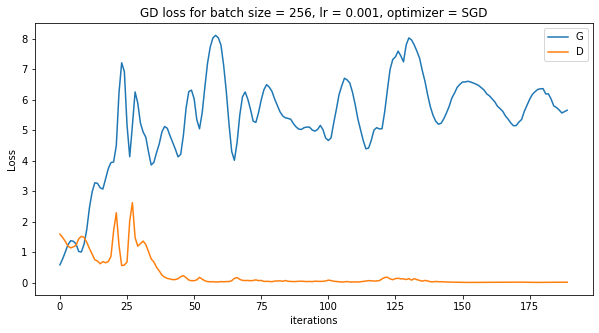

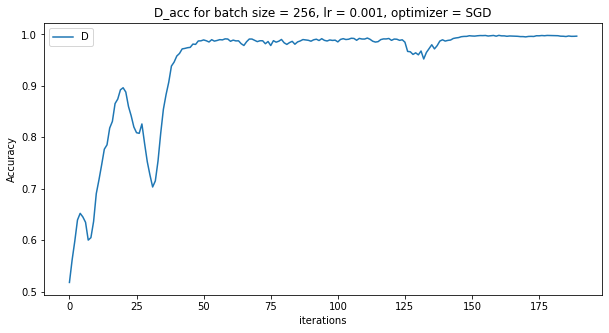

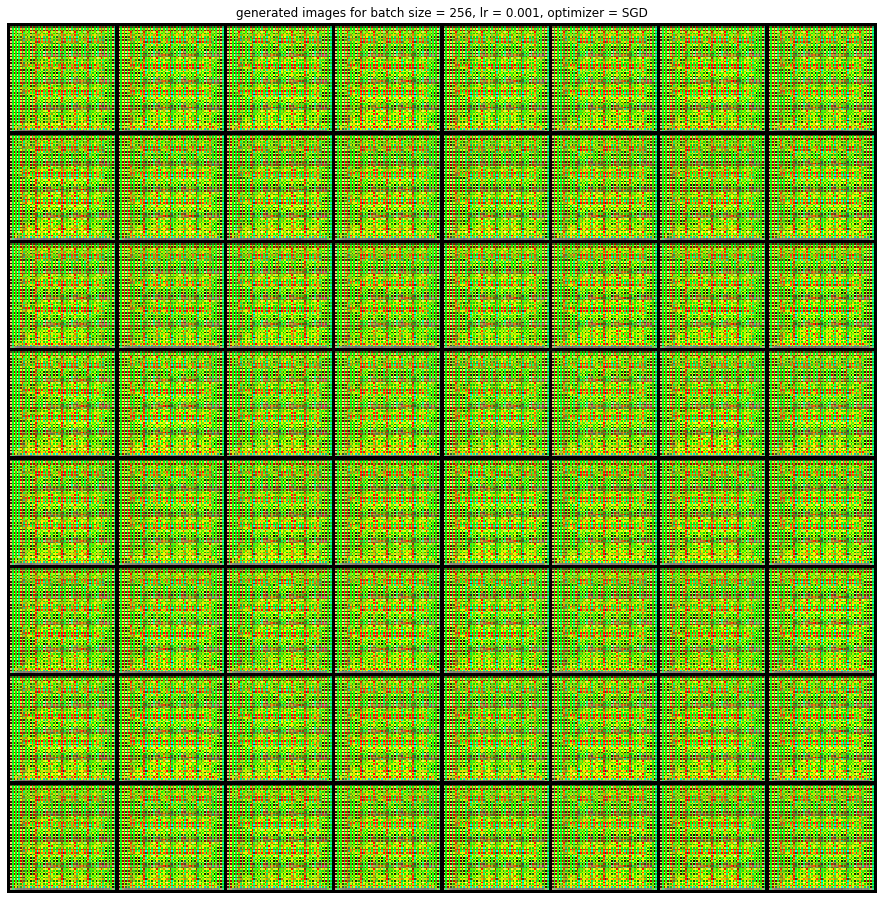

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.4079	Loss_G: 0.0384	D(x): 0.3596	D(G(z)): 0.2792 / 0.9638
[1/10][0/19]	Loss_D: 1.3679	Loss_G: 2.2587	D(x): 0.7686	D(G(z)): 0.6087 / 0.1212
[2/10][0/19]	Loss_D: 1.4063	Loss_G: 0.7206	D(x): 0.4417	D(G(z)): 0.4088 / 0.4939
[3/10][0/19]	Loss_D: 1.3464	Loss_G: 0.9293	D(x): 0.4912	D(G(z)): 0.4215 / 0.4150
[4/10][0/19]	Loss_D: 1.3000	Loss_G: 0.8871	D(x): 0.4859	D(G(z)): 0.4213 / 0.4251
[5/10][0/19]	Loss_D: 1.3487	Loss_G: 1.0552	D(x): 0.5869	D(G(z)): 0.5494 / 0.3616
[6/10][0/19]	Loss_D: 1.5075	Loss_G: 0.8593	D(x): 0.3838	D(G(z)): 0.3969 / 0.4293
[7/10][0/19]	Loss_D: 1.3571	Loss_G: 1.0873	D(x): 0.5673	D(G(z)): 0.5324 / 0.3527
[8/10][0/19]	Loss_D: 1.3777	Loss_G: 1.0932	D(x): 0.5876	D(G(z)): 0.5539 / 0.3509
[9/10][0/19]	Loss_D: 1.3949	Loss_G: 0.7703	D(x): 0.3977	D(G(z)): 0.3469 / 0.4709


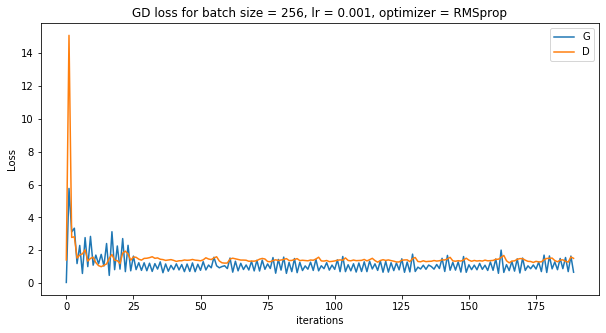

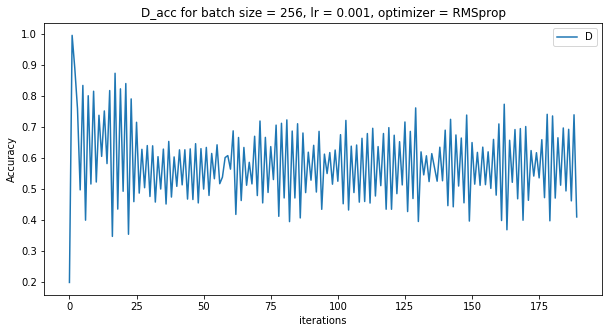

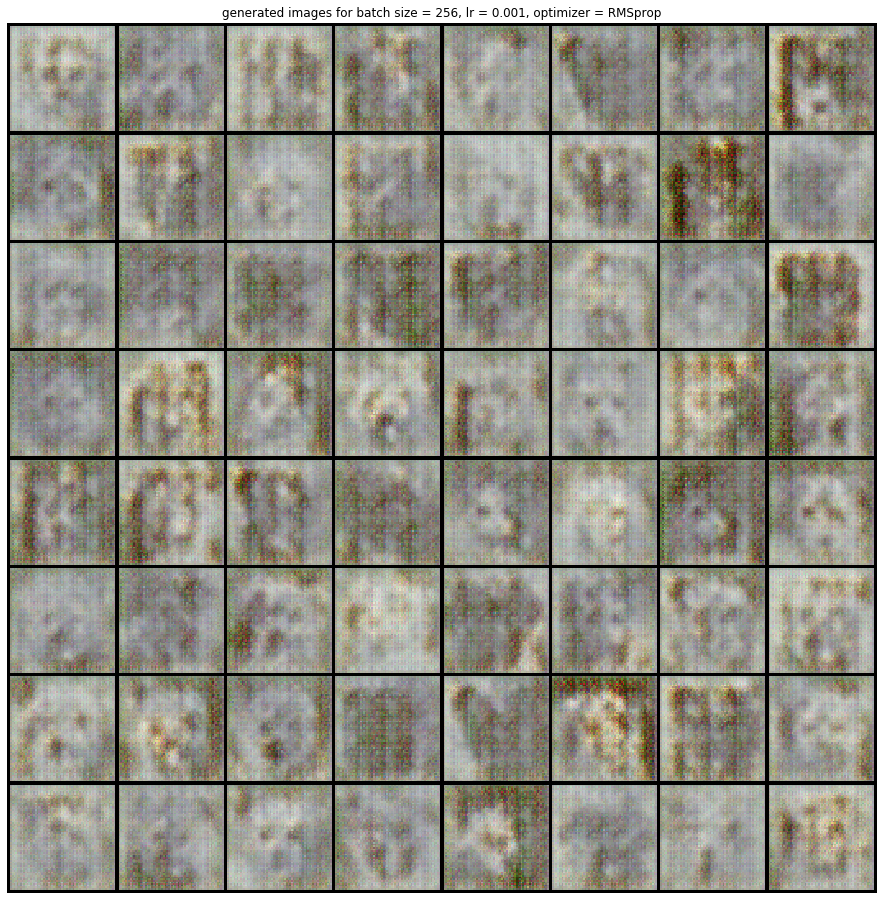

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.5353	Loss_G: 1.8358	D(x): 0.5035	D(G(z)): 0.5426 / 0.1742
[1/10][0/19]	Loss_D: 0.4275	Loss_G: 5.1466	D(x): 0.8029	D(G(z)): 0.1531 / 0.0072
[2/10][0/19]	Loss_D: 0.3060	Loss_G: 6.1302	D(x): 0.9042	D(G(z)): 0.1763 / 0.0035
[3/10][0/19]	Loss_D: 0.4501	Loss_G: 4.2617	D(x): 0.8631	D(G(z)): 0.2379 / 0.0193
[4/10][0/19]	Loss_D: 0.5122	Loss_G: 3.6387	D(x): 0.6981	D(G(z)): 0.0855 / 0.0354
[5/10][0/19]	Loss_D: 0.5907	Loss_G: 3.0763	D(x): 0.7612	D(G(z)): 0.2286 / 0.0546
[6/10][0/19]	Loss_D: 0.4548	Loss_G: 3.8313	D(x): 0.8293	D(G(z)): 0.2070 / 0.0278
[7/10][0/19]	Loss_D: 0.3008	Loss_G: 5.1364	D(x): 0.9198	D(G(z)): 0.1841 / 0.0071
[8/10][0/19]	Loss_D: 1.5783	Loss_G: 5.4146	D(x): 0.8711	D(G(z)): 0.7014 / 0.0082
[9/10][0/19]	Loss_D: 0.6236	Loss_G: 2.8348	D(x): 0.6412	D(G(z)): 0.0740 / 0.0823


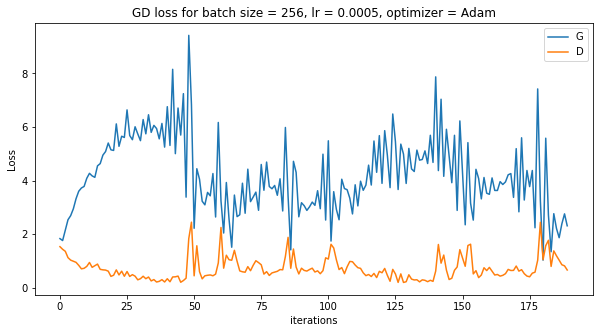

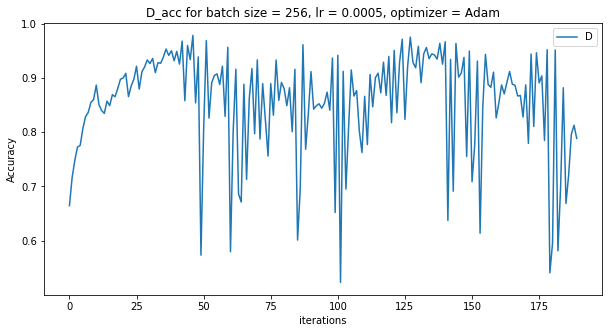

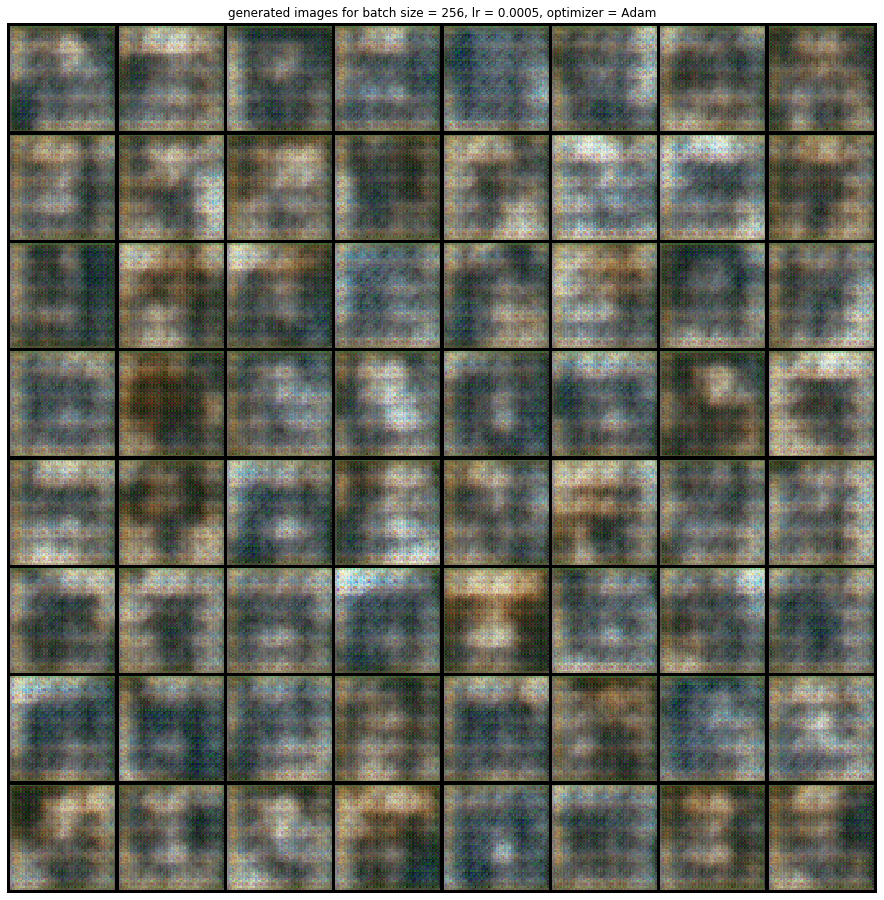

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.4202	Loss_G: 0.7629	D(x): 0.5277	D(G(z)): 0.5093 / 0.4852
[1/10][0/19]	Loss_D: 1.1160	Loss_G: 1.8691	D(x): 0.6558	D(G(z)): 0.4583 / 0.1761
[2/10][0/19]	Loss_D: 0.3786	Loss_G: 4.4640	D(x): 0.7638	D(G(z)): 0.0592 / 0.0143
[3/10][0/19]	Loss_D: 0.4495	Loss_G: 3.7728	D(x): 0.9603	D(G(z)): 0.3204 / 0.0282
[4/10][0/19]	Loss_D: 0.2867	Loss_G: 4.4780	D(x): 0.8558	D(G(z)): 0.0885 / 0.0121
[5/10][0/19]	Loss_D: 0.1481	Loss_G: 5.1700	D(x): 0.9422	D(G(z)): 0.0689 / 0.0061
[6/10][0/19]	Loss_D: 0.0319	Loss_G: 5.5100	D(x): 0.9759	D(G(z)): 0.0058 / 0.0042
[7/10][0/19]	Loss_D: 0.0177	Loss_G: 5.1150	D(x): 0.9931	D(G(z)): 0.0104 / 0.0065
[8/10][0/19]	Loss_D: 0.0393	Loss_G: 5.3201	D(x): 0.9791	D(G(z)): 0.0157 / 0.0057
[9/10][0/19]	Loss_D: 0.0763	Loss_G: 5.4453	D(x): 0.9701	D(G(z)): 0.0413 / 0.0048


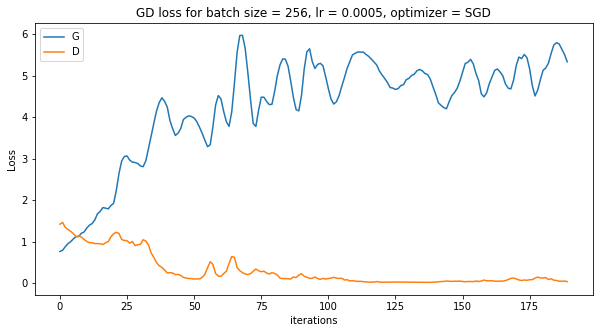

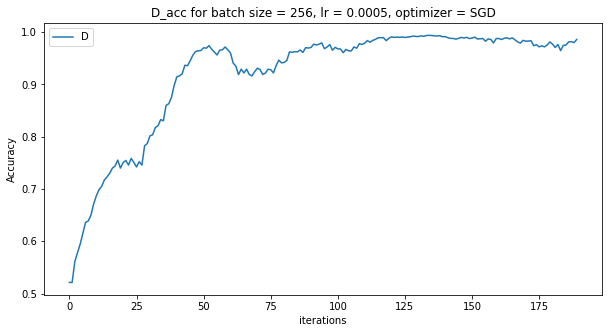

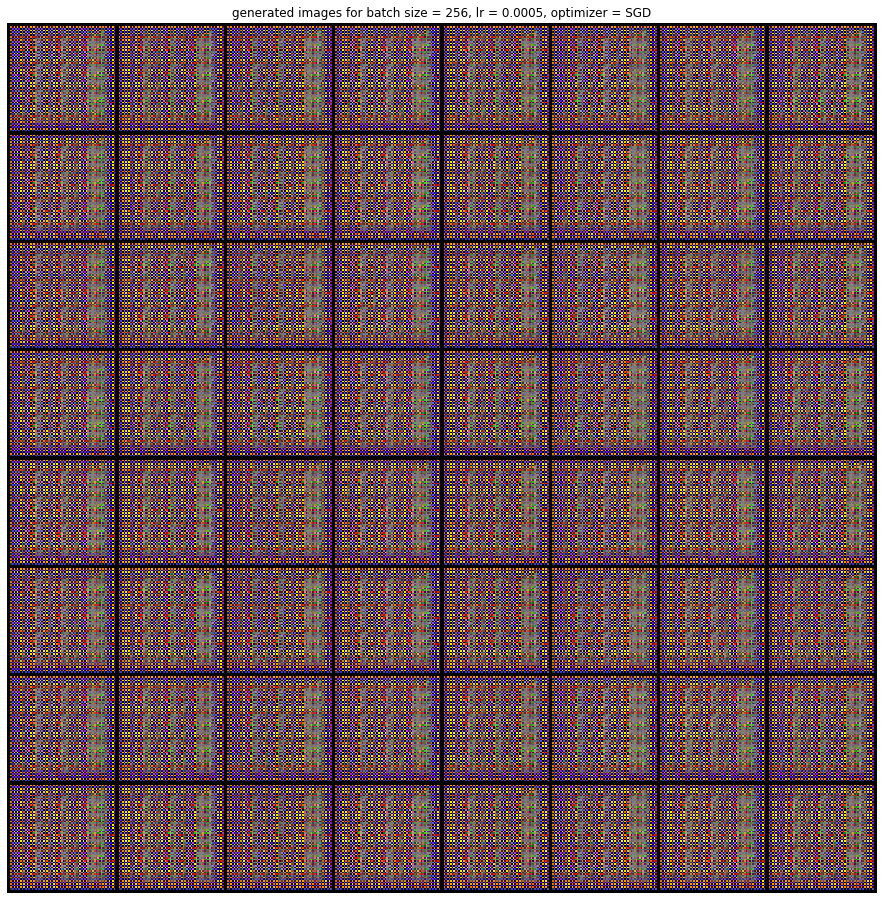

Starting Training Loop...
[0/10][0/19]	Loss_D: 1.4610	Loss_G: 10.7871	D(x): 0.5805	D(G(z)): 0.5681 / 0.0000
[1/10][0/19]	Loss_D: 1.3559	Loss_G: 1.8970	D(x): 0.8493	D(G(z)): 0.6733 / 0.1867
[2/10][0/19]	Loss_D: 1.0322	Loss_G: 1.1273	D(x): 0.5712	D(G(z)): 0.3150 / 0.3293
[3/10][0/19]	Loss_D: 1.6387	Loss_G: 0.7632	D(x): 0.2664	D(G(z)): 0.2248 / 0.4809
[4/10][0/19]	Loss_D: 1.4698	Loss_G: 1.5664	D(x): 0.6024	D(G(z)): 0.6046 / 0.2190
[5/10][0/19]	Loss_D: 1.2685	Loss_G: 1.4815	D(x): 0.6208	D(G(z)): 0.5351 / 0.2331
[6/10][0/19]	Loss_D: 1.2416	Loss_G: 1.2572	D(x): 0.4565	D(G(z)): 0.3505 / 0.2945
[7/10][0/19]	Loss_D: 1.2312	Loss_G: 0.6694	D(x): 0.4157	D(G(z)): 0.2738 / 0.5185
[8/10][0/19]	Loss_D: 1.1580	Loss_G: 0.8120	D(x): 0.5071	D(G(z)): 0.3689 / 0.4496
[9/10][0/19]	Loss_D: 1.1950	Loss_G: 1.3388	D(x): 0.6818	D(G(z)): 0.5478 / 0.2689


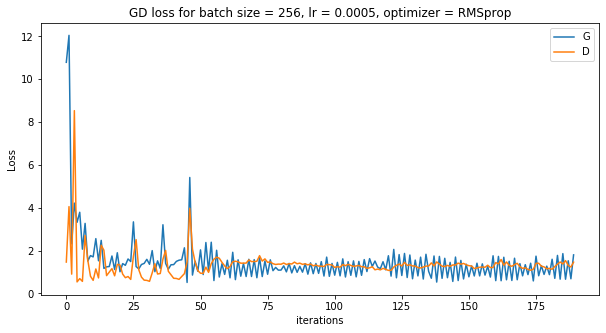

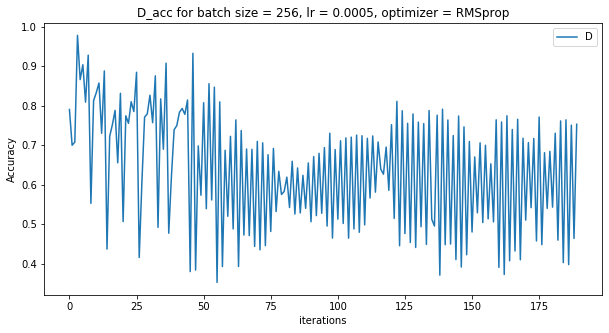

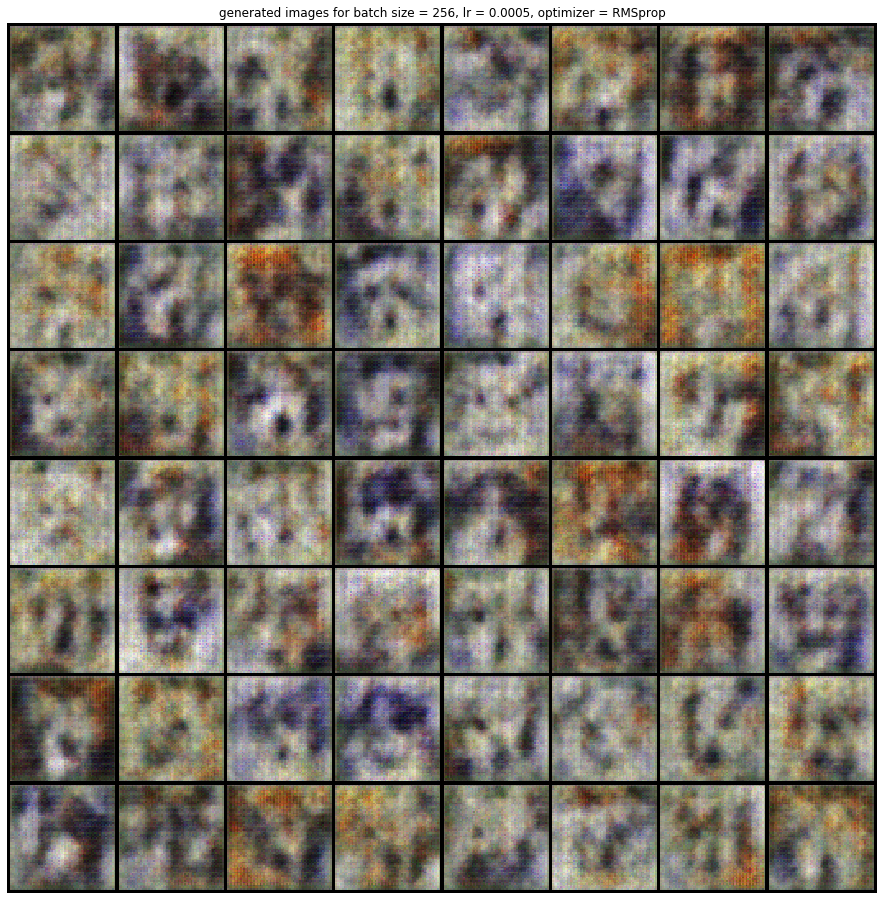

In [8]:
num_epochs = 10

# these are decreaded to speed up the training
# Size of feature maps in generator
ngf = 16

# Size of feature maps in discriminator
ndf = 16


Batch_sizes = [128,256] # removed 64
Lr = [1e-2,1e-3,5e-4]
optimizer = [optim.Adam,optim.SGD,optim.RMSprop]
optim_names = ["Adam","SGD","RMSprop"]

# ------------------- Training Loop --------------------------------


for batch_size in Batch_sizes:
    for lr_idx,lr in enumerate(Lr):
        for optim_idx,opt in enumerate(optimizer):
            # Create the dataset
            dataset = dset.ImageFolder(root=dataroot,
                                       transform=transforms.Compose([
                                           transforms.Resize(image_size),
                                           transforms.CenterCrop(image_size),
                                           transforms.ToTensor(),
                                           transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                       ]))
            # Create the dataloader
            dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                                     shuffle=True, num_workers=workers)
            
            # Decide which device we want to run on
            device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
            
            # Create the generator
            netG = Generator(ngpu,ngf = ngf ).to(device)
            
            # Handle multi-gpu if desired
            if (device.type == 'cuda') and (ngpu > 1):
                netG = nn.DataParallel(netG, list(range(ngpu)))
            
            # Apply the weights_init function to randomly initialize all weights
            #  to mean=0, stdev=0.02.
            netG.apply(weights_init)
            
            # Create the Discriminator
            netD = Discriminator(ngpu, ndf = ndf).to(device)
            
            # Handle multi-gpu if desired
            if (device.type == 'cuda') and (ngpu > 1):
                netD = nn.DataParallel(netD, list(range(ngpu)))
            
            # Apply the weights_init function to randomly initialize all weights
            #  to mean=0, stdev=0.2.
            netD.apply(weights_init)
            
            # Initialize BCELoss function
            criterion = nn.BCELoss()
            
            # Create batch of latent vectors that we will use to visualize
            #  the progression of the generator
            fixed_noise = torch.randn(64, nz, 1, 1, device=device)
            
            
            # Setup Adam optimizers for both G and D
            if opt == optim.SGD:
                optimizerD = opt(netD.parameters(), lr=lr, momentum=0.9)
                optimizerG = opt(netG.parameters(), lr=lr, momentum=0.9)
            elif opt == optim.RMSprop:
                optimizerD = opt(netD.parameters(), lr=lr, alpha=0.99)
                optimizerG = opt(netG.parameters(), lr=lr, alpha=0.99)
            else:
                optimizerD = opt(netD.parameters(), lr=lr, betas=(beta1,0.999))
                optimizerG = opt(netG.parameters(), lr=lr, betas=(beta1,0.999))

            # Training Loop
            G_losses, D_losses, D_accuracy, img_list = train(netG, netD, dataloader, criterion, optimizerD, optimizerG, device, num_epochs= num_epochs)

            plt.figure(figsize=(10,5))
            plt.title("GD loss for batch size = {}, lr = {}, optimizer = {}".format(batch_size,lr,optim_names[optim_idx]))
            plt.plot(G_losses,label="G")
            plt.plot(D_losses,label="D")
            plt.xlabel("iterations")
            plt.ylabel("Loss")
            plt.legend()
            plt.savefig("plots/b/tuning_batch_size_{}_lr_{}_optimizer_{}.png".format(batch_size,lr_idx,optim_names[optim_idx]))
            plt.show()


            # discriminator accuracy
            plt.figure(figsize=(10,5))
            plt.title("D_acc for batch size = {}, lr = {}, optimizer = {}".format(batch_size,lr,optim_names[optim_idx]))
            plt.plot(D_accuracy,label="D")
            plt.xlabel("iterations")
            plt.ylabel("Accuracy")
            plt.legend()
            plt.savefig("plots/b/tuning_batch_size_{}_lr_{}_optimizer_{}_D_acc.png".format(batch_size,lr_idx,optim_names[optim_idx]))
            plt.show()

            # see generator output for fixed noise
            fake = netG(fixed_noise).detach().cpu()
            plt.figure(figsize=(16,16))
            plt.axis("off")
            plt.title("generated images for batch size = {}, lr = {}, optimizer = {}".format(batch_size,lr,optim_names[optim_idx]))
            plt.imshow(np.transpose(vutils.make_grid(fake, padding=2, normalize=True),(1,2,0)))
            plt.savefig("plots/b/process/tuning_batch_size_{}_lr_{}_optimizer_{}_fake.png".format(batch_size,lr_idx,optim_names[optim_idx]))
            plt.show()

            # save the model
            torch.save(netG.state_dict(), 'model_zoo/b/tuning_batch_size_{}_lr_{}_optimizer_{}_netG.pth'.format(batch_size,lr_idx,optim_names[optim_idx]))
            torch.save(netD.state_dict(), 'model_zoo/b/tuning_batch_size_{}_lr_{}_optimizer_{}_netD.pth'.format(batch_size,lr_idx,optim_names[optim_idx]))




# c)

In [6]:
# checking the sizes of the layers
# z of size 100
z = torch.randn(1, 100, 1, 1)
x = nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False)(z)
print(x.shape)
x = nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False)(x)
print(x.shape)
x = nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False)(x)
print(x.shape)
x = nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False)(x)
print(x.shape)
x = nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False)(x)
print(x.shape)

torch.Size([1, 512, 4, 4])
torch.Size([1, 256, 8, 8])
torch.Size([1, 128, 16, 16])
torch.Size([1, 64, 32, 32])
torch.Size([1, 3, 64, 64])


# d)

In [10]:
# load model 
# netG = Generator(ngpu,ngf = ngf ).to(device)
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))





netG.load_state_dict(torch.load('model_zoo/exp1_netG_epoch_40.pth'))

<All keys matched successfully>

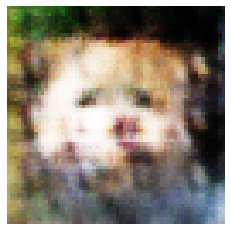

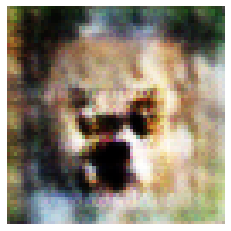

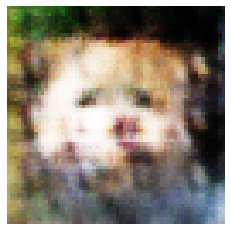

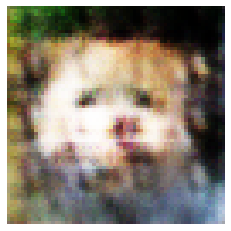

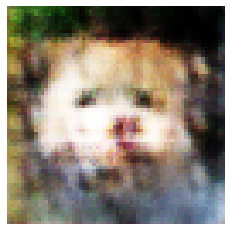

...

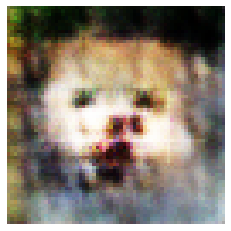

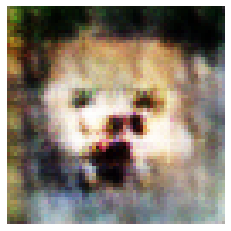

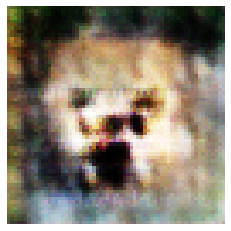

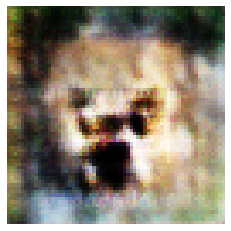

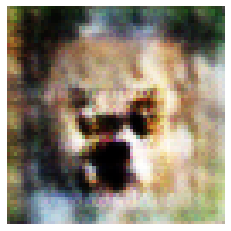

In [21]:
# random seed
torch.manual_seed(42)


# take 2 random latent vectors
z1 = torch.randn(1, 100, 1, 1)
z2 = torch.randn(1, 100, 1, 1)
z3 = torch.randn(1, 100, 1, 1)

# # generate images
# img1 = netG(z1).detach().cpu()
# img2 = netG(z2).detach().cpu()
# img3 = netG(z3).detach().cpu()


def plot(z1):
    img1 = netG(z1).detach().cpu()
    # plot images
    plt.figure(figsize=(4,4))
    plt.axis("off")
    # plt.title("generated images")
    plt.imshow(np.transpose(vutils.make_grid(img1, padding=2, normalize=True),(1,2,0)))
    # plt.savefig("plots/exp1_img1.png")
    plt.show()


alpha = np.linspace(0,1,10)
z = []
for a in alpha:
    z.append((1-a)*z1 + a*z2)

plot(z1)
plot(z2)
for i in range(len(z)):
    plot(z[i])

